# Credit Risk Dataset (CRD)

In [ ]:
pip install pandas numpy matplotlib seaborn scikit-learn imbalanced-learn xgboost lightgbm catboost optuna shap lime SALib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 10.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 778.9/778.9 kB 38.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.7/242.7 kB 17.0 MB/s eta 0:00:00
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=b1bc6535b438fe4ed91183061593f9b20f3858060b869082a59de6a1ced85a8d
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


Import Libriries

In [ ]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import ADASYN
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
import optuna
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, classification_report
)
from scipy.stats import ttest_rel, wilcoxon
import shap
import lime
import lime.lime_tabular
from SALib.sample import morris as morris_sample
from SALib.analyze import morris as morris_analyze


In [ ]:
# Load dataset
df = pd.read_csv('/content/credit_risk_dataset.csv')
df.dropna(inplace=True)
df.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length
0,22,59000,RENT,123.0,PERSONAL,D,35000,16.02,1,0.59,Y,3
1,21,9600,OWN,5.0,EDUCATION,B,1000,11.14,0,0.10,N,2
2,25,9600,MORTGAGE,1.0,MEDICAL,C,5500,12.87,1,0.57,N,3
3,23,65500,RENT,4.0,MEDICAL,C,35000,15.23,1,0.53,N,2
4,24,54400,RENT,8.0,MEDICAL,C,35000,14.27,1,0.55,Y,4


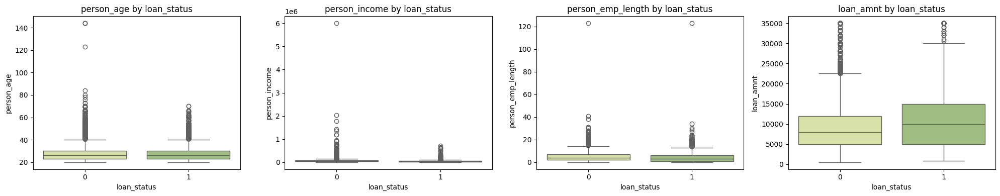

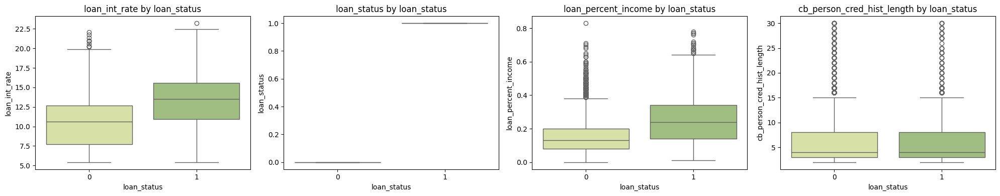

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define custom colors for the two categories in loan_status
custom_palette = {"1": "#A0C878", "0": "#DDEB9D"}  # Blue and Orange

numeric_cols = df.select_dtypes(include='number').columns.tolist()

def plot_box_plots(df, columns, target='loan_status', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.boxplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_box_plots(df, numeric_cols)


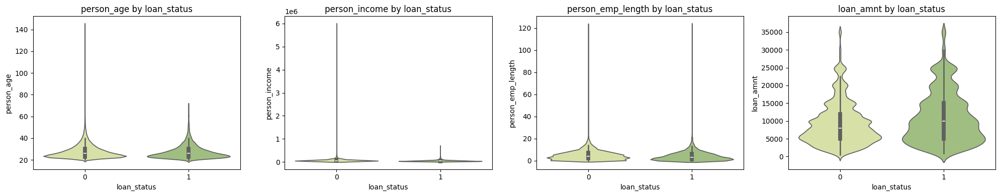

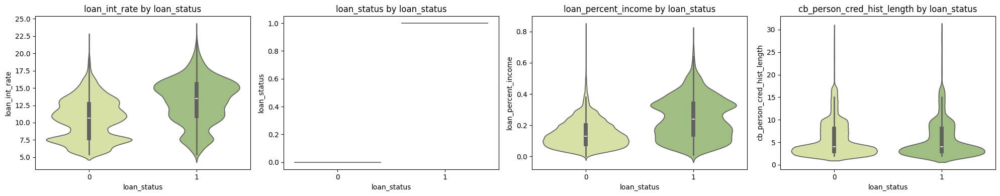

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define custom colors for the two categories in loan_status
custom_palette = {"1": "#A0C878", "0": "#DDEB9D"}

def plot_violin_plots(df, columns, target='loan_status', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.violinplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_violin_plots(df, numeric_cols)


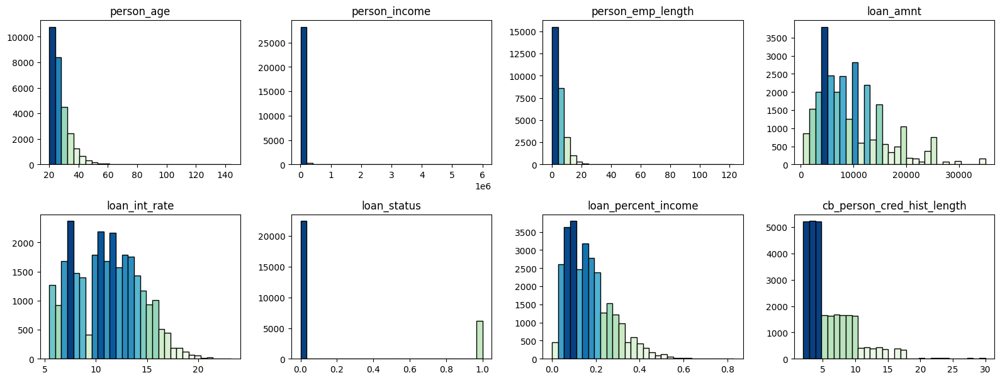

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_histograms(df, columns, cols_per_row=4):
    total = len(columns)
    rows = (total // cols_per_row) + 1
    plt.figure(figsize=(cols_per_row * 4, rows * 3))

    for i, col in enumerate(columns):
        plt.subplot(rows, cols_per_row, i + 1)
        values, bins = np.histogram(df[col].dropna(), bins=30)

        # Normalize values to [0, 1] for color mapping
        norm = Normalize(vmin=min(values), vmax=max(values))
        colors = cm.GnBu(norm(values))

        for j in range(len(values)):
            plt.bar(bins[j], values[j], width=bins[j+1] - bins[j],
                    color=colors[j], edgecolor='black', align='edge')

        plt.title(col)

    plt.tight_layout()
    plt.show()

plot_histograms(df, numeric_cols)


In [ ]:

target = 'loan_status'

numeric_features = [
    'person_age', 'person_income', 'person_emp_length',
    'loan_amnt', 'loan_int_rate', 'loan_percent_income', 'cb_person_cred_hist_length'
]

categorical_features = [
    'person_home_ownership', 'loan_intent', 'loan_grade', 'cb_person_default_on_file'
]

# ----------------------
# 1. Label Encode Categorical Features
# ----------------------
label_encoders = {}
for col in categorical_features:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

# ----------------------
# 2. Normalize Numeric Features
# ----------------------
scaler = StandardScaler()
df[numeric_features] = scaler.fit_transform(df[numeric_features])

# ----------------------
# 3. Print Processed Data
# ----------------------
print("\nPreprocessed Dataset:")
df.head()

# Optional: Separate features and label for model input
X = df.drop(columns=[target])
y = df[target]


Preprocessed Dataset:


In [ ]:
df.head()

,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_status,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length
0,-0.907594,-0.122674,3,28.453433,4,3,4.003984,1.542164,1,3.952527,1,-0.691791
1,-1.066064,-0.914907,2,0.050866,1,1,-1.367627,0.031008,0,-0.653141,0,-0.939413
2,-0.432183,-0.914907,0,-0.911932,3,2,-0.656678,0.566725,1,3.764540,0,-0.691791
3,-0.749123,-0.018433,3,-0.189833,3,2,4.003984,1.297530,1,3.388567,0,-0.939413
4,-0.590653,-0.196445,3,0.772966,3,2,4.003984,1.000253,1,3.576554,1,-0.444169


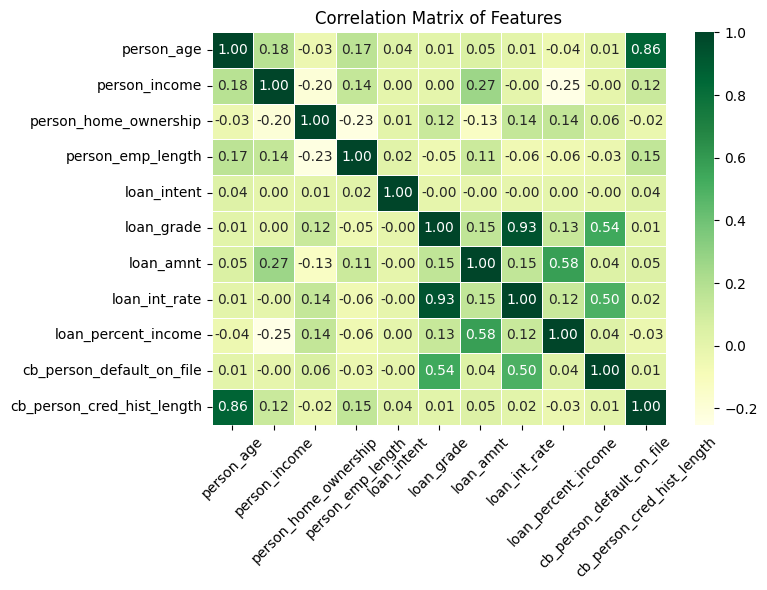

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Drop the target column
df_corr = df.drop(columns=['loan_status'])
df_corr_numeric = df_corr.select_dtypes(include=['float64', 'int64'])
corr_matrix = df_corr_numeric.corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='YlGn', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix of Features')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

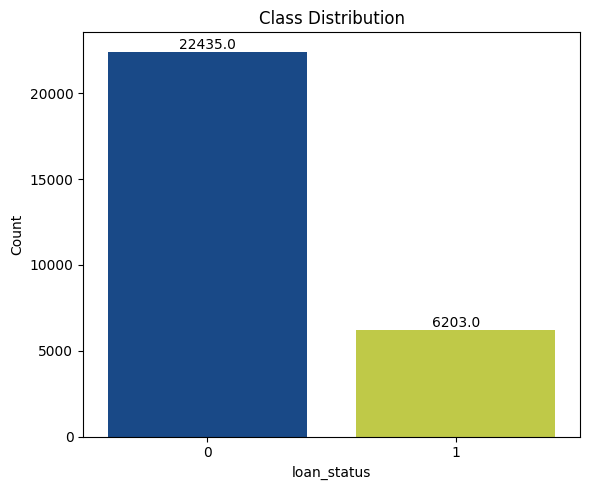

In [ ]:
plt.figure(figsize=(6, 5))
ax = sns.countplot(x='loan_status', data=df, palette=["#074799", "#D2DE32"])
plt.title("Class Distribution")
plt.xlabel("loan_status")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()

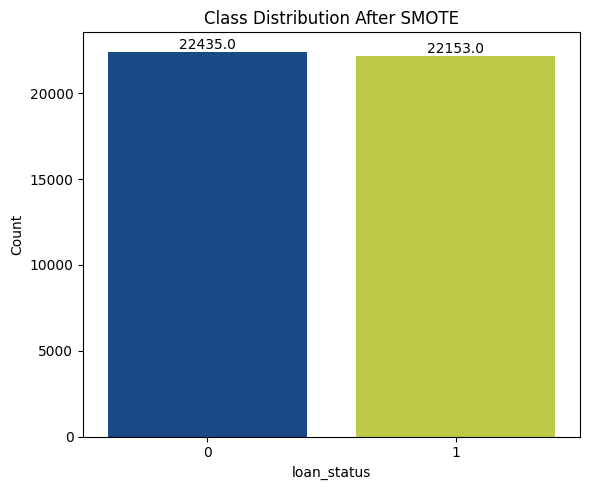


🔍 Model: Decision Tree
              precision    recall  f1-score   support

           0     0.8821    0.8721    0.8771      4487
           1     0.8719    0.8820    0.8769      4431

    accuracy                         0.8770      8918
   macro avg     0.8770    0.8770    0.8770      8918
weighted avg     0.8770    0.8770    0.8770      8918

Sensitivity (Recall): 0.8820
Specificity: 0.8721
Matthews Correlation Coefficient (MCC): 0.7540
Cohen's Kappa: 0.7540

🔍 Model: Logistic Regression
              precision    recall  f1-score   support

           0     0.7018    0.7127    0.7072      4487
           1     0.7044    0.6933    0.6988      4431

    accuracy                         0.7031      8918
   macro avg     0.7031    0.7030    0.7030      8918
weighted avg     0.7031    0.7031    0.7030      8918

Sensitivity (Recall): 0.6933
Specificity: 0.7127
Matthews Correlation Coefficient (MCC): 0.4061
Cohen's Kappa: 0.4061

🔍 Model: Random Forest
              precision    recal

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    make_scorer, matthews_corrcoef, cohen_kappa_score
)
from imblearn.over_sampling import ADASYN

# ML Models
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier


# Apply ADASYN
adasyn = ADASYN(random_state=42)
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Plot class distribution
plt.figure(figsize=(6, 5))
ax = sns.countplot(x=y_resampled, palette=["#074799", "#D2DE32"])
plt.title("Class Distribution After SMOTE")
plt.xlabel("loan_status")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()


# ------------- Train/Test Split ---------------- #
X_train, X_test, y_train, y_test = train_test_split(
    X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled
)

# ------------- Models Dictionary ---------------- #
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'KNN': KNeighborsClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
    'LightGBM': LGBMClassifier(),
    'CatBoost': CatBoostClassifier(verbose=0)
}

# ------------- Evaluation ---------------- #
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()
    sensitivity = recall_score(y_test, y_pred)  # TP / (TP + FN)
    specificity = TN / (TN + FP)
    mcc = matthews_corrcoef(y_test, y_pred)
    kappa = cohen_kappa_score(y_test, y_pred)

    print(f"\n🔍 Model: {name}")
    print(classification_report(y_test, y_pred, digits=4))
    print(f"Sensitivity (Recall): {sensitivity:.4f}")
    print(f"Specificity: {specificity:.4f}")
    print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
    print(f"Cohen's Kappa: {kappa:.4f}")

<Figure size 1000x800 with 0 Axes>

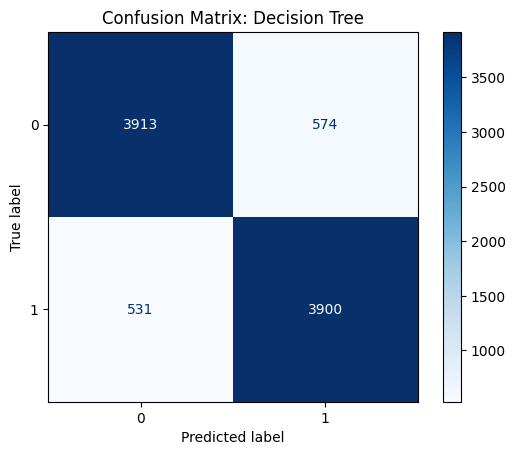

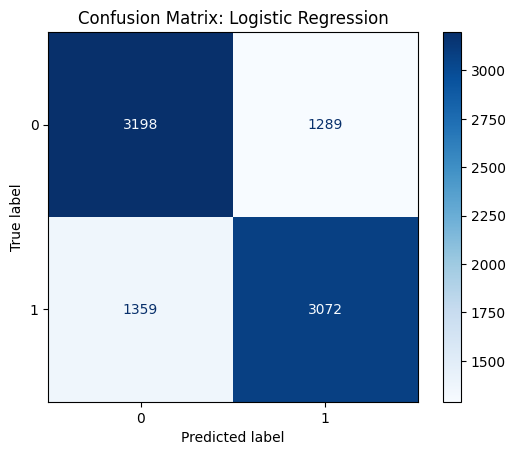

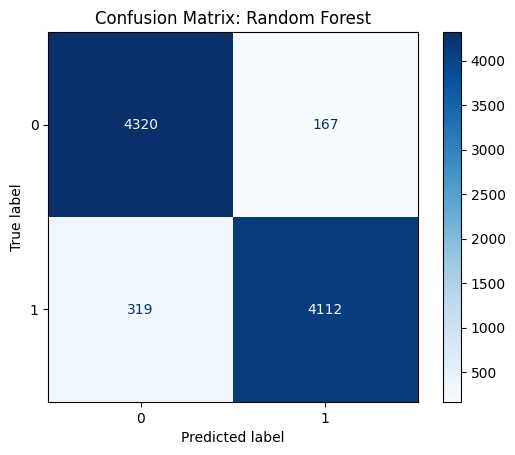

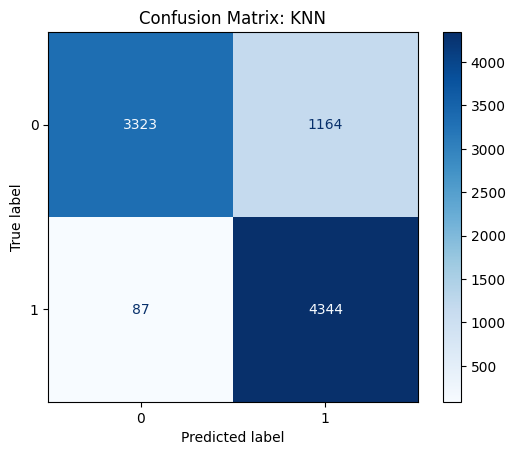

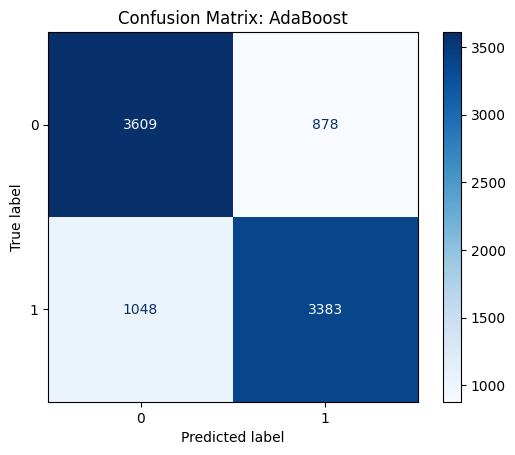

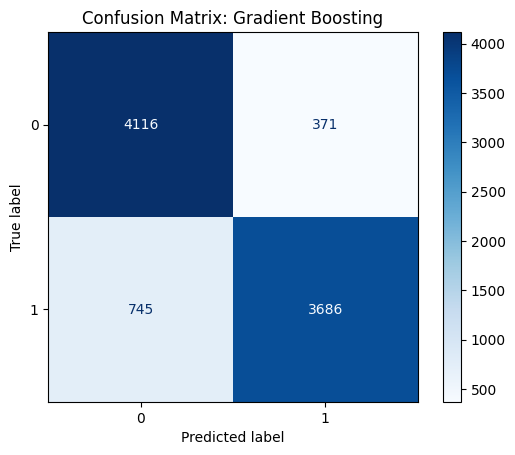

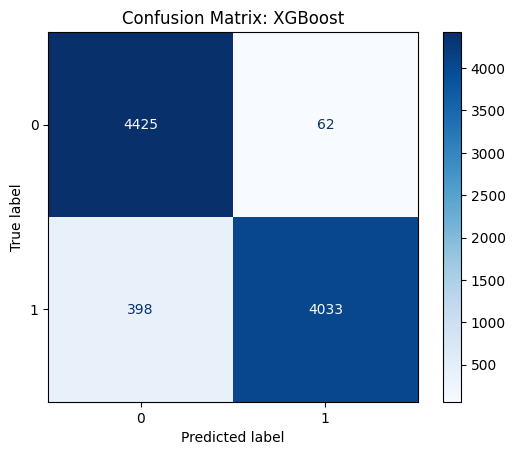

[LightGBM] [Info] Number of positive: 17722, number of negative: 17948
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001203 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1801
[LightGBM] [Info] Number of data points in the train set: 35670, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.496832 -> initscore=-0.012672
[LightGBM] [Info] Start training from score -0.012672


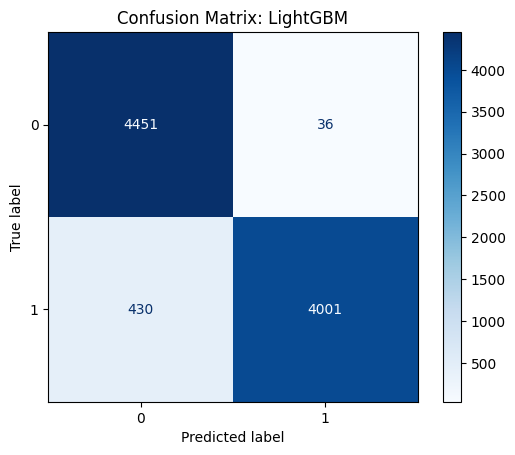

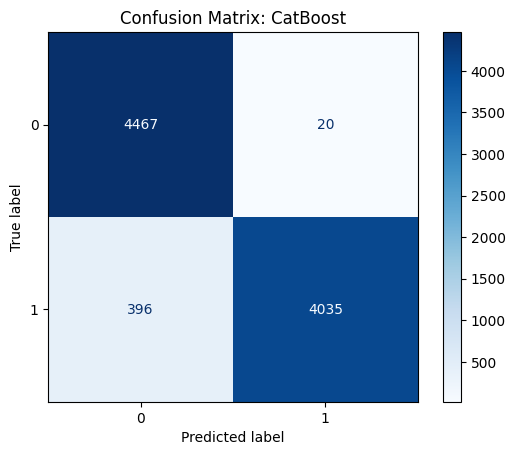

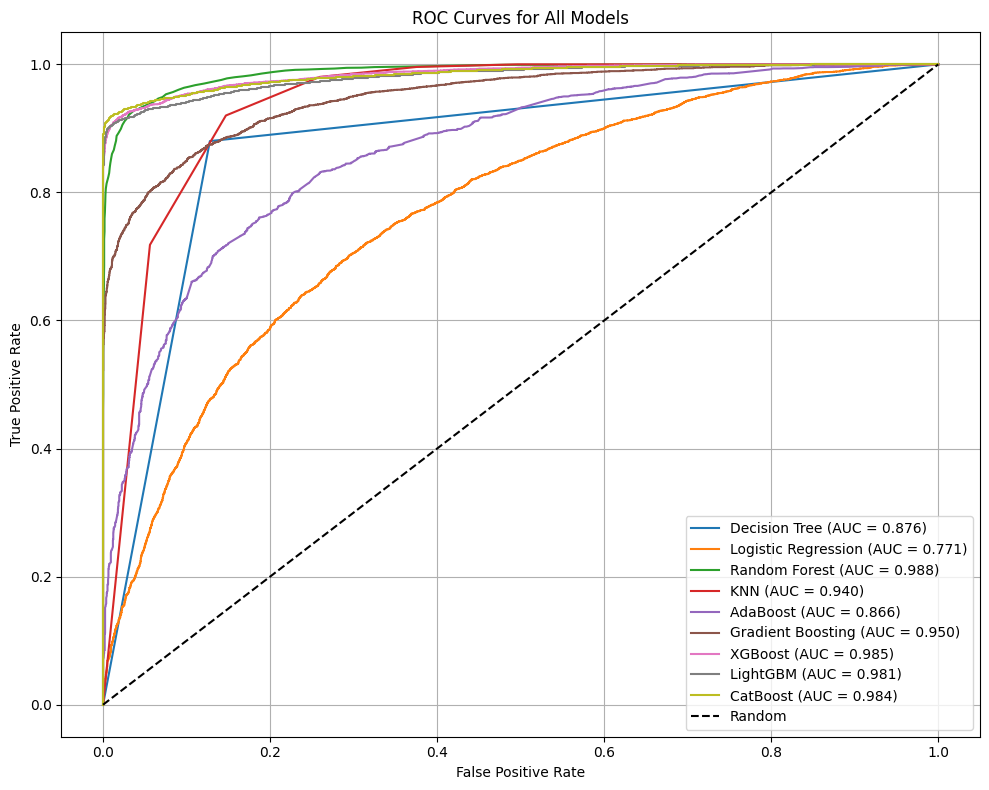

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay, roc_curve, auc
import matplotlib.pyplot as plt

# Store ROC data
plt.figure(figsize=(10, 8))
roc_data = {}

for name, model in models.items():
    # Fit model and predict
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # --- Plot Confusion Matrix ---
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(cmap='Blues')
    plt.title(f"Confusion Matrix: {name}")
    plt.show()

    # --- Calculate ROC Curve ---
    if hasattr(model, "predict_proba"):
        y_score = model.predict_proba(X_test)[:, 1]
    else:
        y_score = model.decision_function(X_test)

    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    roc_data[name] = (fpr, tpr, roc_auc)

# --- Plot All ROC Curves Together ---
plt.figure(figsize=(10, 8))
for name, (fpr, tpr, roc_auc) in roc_data.items():
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.3f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for All Models')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()


[I 2025-06-19 22:26:21,393] A new study created in memory with name: no-name-0b603203-76f4-4231-b639-6415c4b753d0
[I 2025-06-19 22:26:53,494] Trial 0 finished with value: 0.9479062024626159 and parameters: {'rf_n_estimators': 71, 'rf_max_depth': 14, 'rf_min_samples_split': 2, 'xgb_n_estimators': 87, 'xgb_max_depth': 16, 'xgb_learning_rate': 0.05196241648223969, 'xgb_subsample': 0.9350526123131688, 'xgb_colsample_bytree': 0.6602987885882585, 'lr_C': 0.09402521924835641, 'meta_C': 4.847349428502808}. Best is trial 0 with value: 0.9479062024626159.
[I 2025-06-19 22:27:14,371] Trial 1 finished with value: 0.9359454360760412 and parameters: {'rf_n_estimators': 85, 'rf_max_depth': 12, 'rf_min_samples_split': 7, 'xgb_n_estimators': 96, 'xgb_max_depth': 4, 'xgb_learning_rate': 0.2637356915044859, 'xgb_subsample': 0.5995328809677547, 'xgb_colsample_bytree': 0.6200491181173007, 'lr_C': 0.0997550805556927, 'meta_C': 0.23094917128290673}. Best is trial 0 with value: 0.9479062024626159.
[I 2025-06-

Best hyperparameters:
{'rf_n_estimators': 197, 'rf_max_depth': 16, 'rf_min_samples_split': 9, 'xgb_n_estimators': 268, 'xgb_max_depth': 17, 'xgb_learning_rate': 0.07765506633749442, 'xgb_subsample': 0.7568651929475227, 'xgb_colsample_bytree': 0.8033375855535019, 'lr_C': 0.2870323856779229, 'meta_C': 0.5677329624141539}

 BO-StaEnsemble Model Evaluation:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      4487
           1       0.98      0.93      0.96      4431

    accuracy                           0.96      8918
   macro avg       0.96      0.96      0.96      8918
weighted avg       0.96      0.96      0.96      8918

Sensitivity (Recall): 0.9323
Specificity: 0.9822
Matthews Correlation Coefficient (MCC): 0.9159
Cohen's Kappa: 0.9147


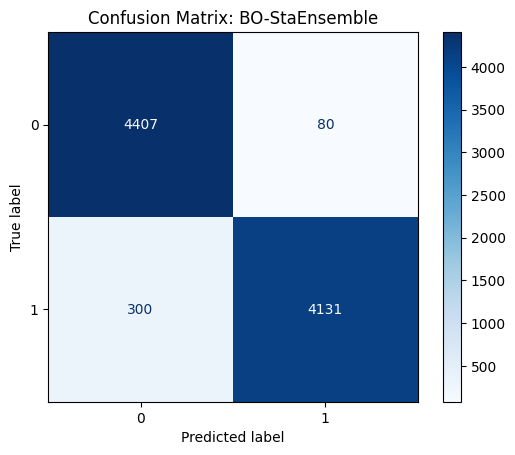

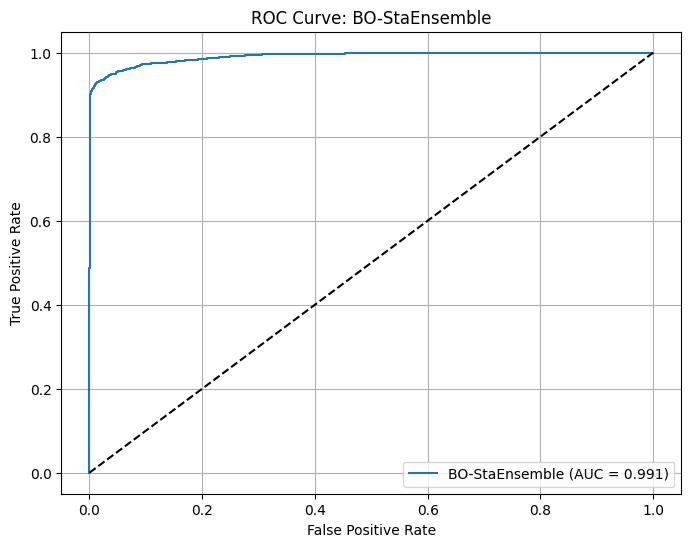

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    matthews_corrcoef, cohen_kappa_score, roc_curve, auc, ConfusionMatrixDisplay
)
from sklearn.model_selection import StratifiedKFold
import optuna
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier


# Base learners creation functions
def create_rf(trial):
    return RandomForestClassifier(
        n_estimators=trial.suggest_int('rf_n_estimators', 50, 300),
        max_depth=trial.suggest_int('rf_max_depth', 3, 20),
        min_samples_split=trial.suggest_int('rf_min_samples_split', 2, 10),
        random_state=42
    )

def create_xgb(trial):
    return XGBClassifier(
        n_estimators=trial.suggest_int('xgb_n_estimators', 50, 300),
        max_depth=trial.suggest_int('xgb_max_depth', 3, 20),
        learning_rate=trial.suggest_float('xgb_learning_rate', 0.01, 0.3),
        subsample=trial.suggest_float('xgb_subsample', 0.5, 1.0),
        colsample_bytree=trial.suggest_float('xgb_colsample_bytree', 0.5, 1.0),
        use_label_encoder=False,
        eval_metric='logloss',
        random_state=42
    )

def create_lr(trial):
    return LogisticRegression(
        C=trial.suggest_float('lr_C', 0.01, 10.0, log=True),
        max_iter=1000,
        solver='lbfgs',
        random_state=42
    )

base_learners = ['rf', 'xgb', 'lr']

# Generate out-of-fold predictions for stacking meta-features
def stacking_oof_preds(X, y, trial, n_splits=5):
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    oof_preds = {learner: np.zeros(len(y)) for learner in base_learners}

    for train_idx, val_idx in skf.split(X, y):
        X_train_fold, X_val_fold = X.iloc[train_idx], X.iloc[val_idx]
        y_train_fold = y.iloc[train_idx]

        rf = create_rf(trial)
        rf.fit(X_train_fold, y_train_fold)
        oof_preds['rf'][val_idx] = rf.predict_proba(X_val_fold)[:,1]

        xgb = create_xgb(trial)
        xgb.fit(X_train_fold, y_train_fold)
        oof_preds['xgb'][val_idx] = xgb.predict_proba(X_val_fold)[:,1]

        lr = create_lr(trial)
        lr.fit(X_train_fold, y_train_fold)
        oof_preds['lr'][val_idx] = lr.predict_proba(X_val_fold)[:,1]

    meta_features = np.column_stack([oof_preds[learner] for learner in base_learners])
    return meta_features

# Objective function for Optuna
def objective(trial):
    meta_X = stacking_oof_preds(X_train, y_train, trial)

    meta_C = trial.suggest_float('meta_C', 0.01, 10.0, log=True)
    meta_model = LogisticRegression(C=meta_C, max_iter=1000, random_state=42)

    meta_model.fit(meta_X, y_train)
    preds = meta_model.predict(meta_X)
    return f1_score(y_train, preds)

# Run the optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)

print("Best hyperparameters:")
print(study.best_trial.params)

# Retrain base learners on full training set with best params
best_params = study.best_trial.params

rf_best = RandomForestClassifier(
    n_estimators=best_params['rf_n_estimators'],
    max_depth=best_params['rf_max_depth'],
    min_samples_split=best_params['rf_min_samples_split'],
    random_state=42
)
xgb_best = XGBClassifier(
    n_estimators=best_params['xgb_n_estimators'],
    max_depth=best_params['xgb_max_depth'],
    learning_rate=best_params['xgb_learning_rate'],
    subsample=best_params['xgb_subsample'],
    colsample_bytree=best_params['xgb_colsample_bytree'],
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)
lr_best = LogisticRegression(
    C=best_params['lr_C'],
    max_iter=1000,
    solver='lbfgs',
    random_state=42
)

# Fit base learners on full training set
rf_best.fit(X_train, y_train)
xgb_best.fit(X_train, y_train)
lr_best.fit(X_train, y_train)

# Create meta features for train and test
def create_meta_features(models, X):
    meta_features = np.column_stack([
        model.predict_proba(X)[:,1] for model in models
    ])
    return meta_features

base_models = [rf_best, xgb_best, lr_best]

meta_X_train = create_meta_features(base_models, X_train)
meta_X_test = create_meta_features(base_models, X_test)

# Train meta learner with best meta_C
meta_model = LogisticRegression(C=best_params['meta_C'], max_iter=1000, random_state=42)
meta_model.fit(meta_X_train, y_train)

# Final predictions
y_pred = meta_model.predict(meta_X_test)
y_proba = meta_model.predict_proba(meta_X_test)[:,1]

# Evaluation metrics
cm = confusion_matrix(y_test, y_pred)
TN, FP, FN, TP = cm.ravel()
sensitivity = recall_score(y_test, y_pred)  # Recall
specificity = TN / (TN + FP)
mcc = matthews_corrcoef(y_test, y_pred)
kappa = cohen_kappa_score(y_test, y_pred)

print("\n BO-StaEnsemble Model Evaluation:")
print(classification_report(y_test, y_pred))
print(f"Sensitivity (Recall): {sensitivity:.4f}")
print(f"Specificity: {specificity:.4f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
print(f"Cohen's Kappa: {kappa:.4f}")

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap='Blues')
plt.title("Confusion Matrix: BO-StaEnsemble")
plt.show()

# Plot ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, label=f'BO-StaEnsemble (AUC = {roc_auc:.3f})')
plt.plot([0,1], [0,1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve: BO-StaEnsemble')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


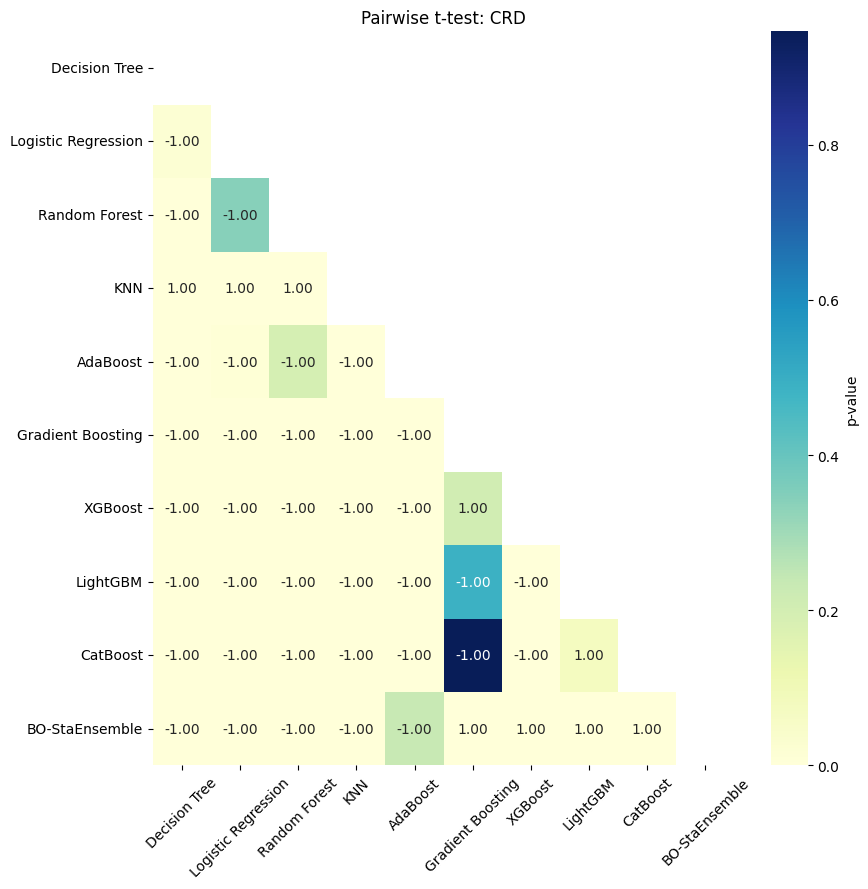

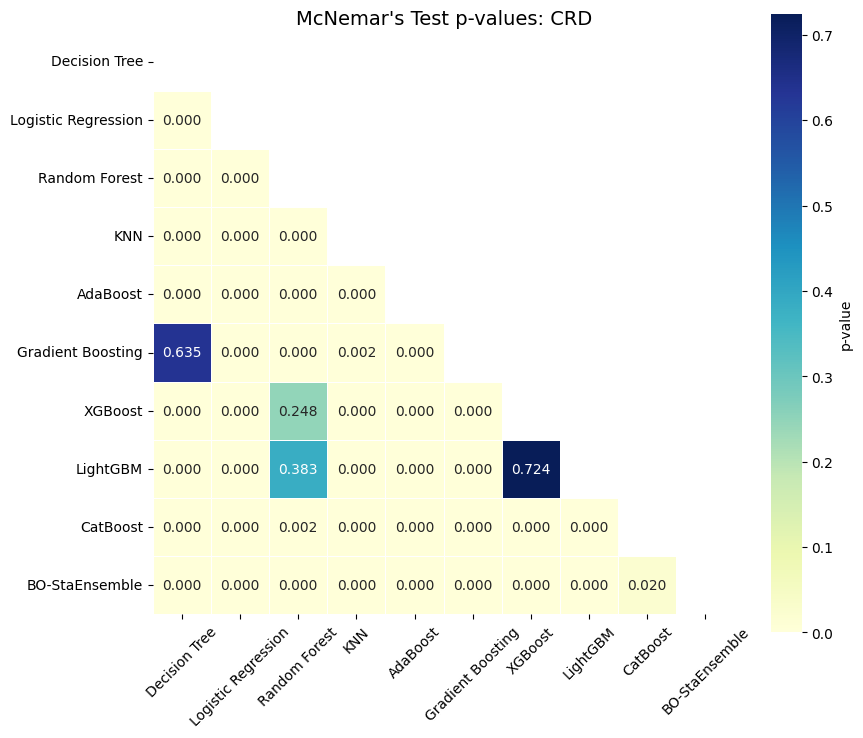

In [ ]:
from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Store predictions from trained models
model_preds = {}
for name, model in models.items():
    model_preds[name] = model.predict(X_test)

# Add BO-StaEnsemble prediction manually (assuming already available)
model_preds['BO-StaEnsemble'] = y_pred  # y_pred from BO-StaEnsemble

from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

model_names = list(model_preds.keys())
n_models = len(model_names)

# Initialize matrices
t_stat_matrix = np.zeros((n_models, n_models))
p_val_matrix = np.zeros((n_models, n_models))
mcnemar_p_matrix = np.ones((n_models, n_models))

# Run tests
for i in range(n_models):
    for j in range(n_models):
        if i == j:
            continue
        pred_i = model_preds[model_names[i]]
        pred_j = model_preds[model_names[j]]

        # Paired t-test
        t_stat, p_val = ttest_rel(pred_i, pred_j)
        t_stat_matrix[i, j] = np.sign(t_stat)
        p_val_matrix[i, j] = p_val

        # McNemar's Test
        b = np.logical_and(pred_i == y_test, pred_j != y_test).sum()
        c = np.logical_and(pred_i != y_test, pred_j == y_test).sum()
        table = np.array([[0, b], [c, 0]])
        try:
            result = mcnemar(table, exact=True)
            mcnemar_p_matrix[i, j] = result.pvalue
        except:
            mcnemar_p_matrix[i, j] = np.nan

# Convert to DataFrames
t_stat_df = pd.DataFrame(t_stat_matrix, index=model_names, columns=model_names)
p_val_df = pd.DataFrame(p_val_matrix, index=model_names, columns=model_names)
mcnemar_p_df = pd.DataFrame(mcnemar_p_matrix, index=model_names, columns=model_names)

# Heatmap: t-test p-values & signs
plt.figure(figsize=(9, 9))
sns.heatmap(p_val_df, annot=t_stat_df, fmt='.2f', cmap='YlGnBu',
            mask=np.triu(np.ones_like(p_val_df, dtype=bool)),
            cbar_kws={'label': 'p-value'})
plt.title('Pairwise t-test: CRD')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# Heatmap: McNemar's p-values (Lower Triangle Only)
mask = np.triu(np.ones_like(mcnemar_p_df, dtype=bool))  # Upper triangle mask

plt.figure(figsize=(9, 9))
sns.heatmap(mcnemar_p_df, annot=True, fmt=".3f", cmap="YlGnBu",
            mask=mask, linewidths=0.5, square=True,
            cbar_kws={"label": "p-value", "shrink": .75})
plt.title("McNemar's Test p-values: CRD", fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



In [ ]:
# Print Pairwise t-test p-values (Lower Triangle Only)
print("📌 Pairwise t-test p-values (lower triangle):\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {p_val_matrix[i, j]:.4f}")
print("\n")

# Print Pairwise t-statistic signs (Upper Triangle Only)
print("📌 Pairwise t-test t-statistic sign (upper triangle):\n")
for i in range(n_models):
    for j in range(i+1, n_models):
        sign = "+" if t_stat_matrix[i, j] > 0 else "-" if t_stat_matrix[i, j] < 0 else "0"
        print(f"{model_names[i]} vs {model_names[j]}: t-sign = {sign}")
print("\n")

# Print Pairwise McNemar's Test p-values
print("📌 Pairwise McNemar's Test p-values:\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {mcnemar_p_matrix[i, j]:.4f}")


📌 Pairwise t-test p-values (lower triangle):

Logistic Regression vs Decision Tree: p-value = 0.0435
Random Forest vs Decision Tree: p-value = 0.0000
Random Forest vs Logistic Regression: p-value = 0.1940
KNN vs Decision Tree: p-value = 0.0000
KNN vs Logistic Regression: p-value = 0.0000
KNN vs Random Forest: p-value = 0.0000
AdaBoost vs Decision Tree: p-value = 0.0000
AdaBoost vs Logistic Regression: p-value = 0.0106
AdaBoost vs Random Forest: p-value = 0.3743
AdaBoost vs KNN: p-value = 0.0000
Gradient Boosting vs Decision Tree: p-value = 0.0000
Gradient Boosting vs Logistic Regression: p-value = 0.0000
Gradient Boosting vs Random Forest: p-value = 0.0000
Gradient Boosting vs KNN: p-value = 0.0000
Gradient Boosting vs AdaBoost: p-value = 0.0000
XGBoost vs Decision Tree: p-value = 0.0000
XGBoost vs Logistic Regression: p-value = 0.0000
XGBoost vs Random Forest: p-value = 0.0000
XGBoost vs KNN: p-value = 0.0000
XGBoost vs AdaBoost: p-value = 0.0001
XGBoost vs Gradient Boosting: p-value 

Model Agreement Matrix (Prediction Similarity)

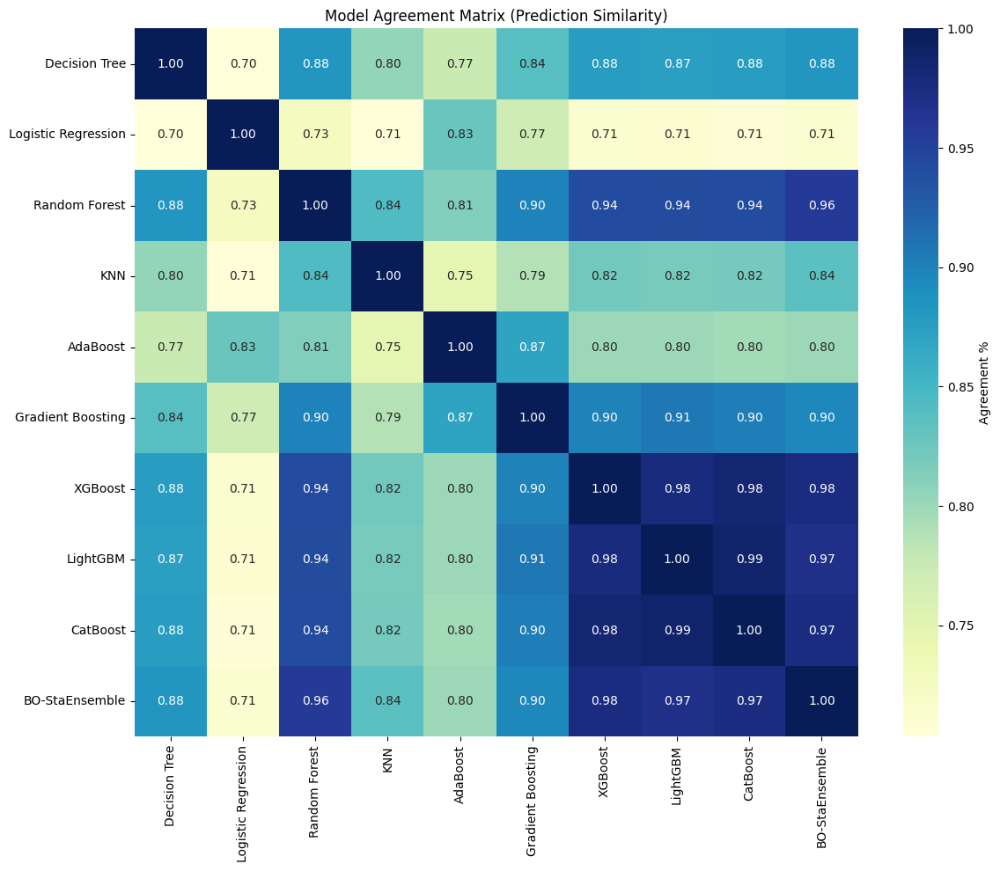

In [ ]:
# Agreement Matrix (percentage of same predictions between model pairs)
agreement_matrix = np.zeros((n_models, n_models))

for i in range(n_models):
    for j in range(n_models):
        agree = (model_preds[model_names[i]] == model_preds[model_names[j]]).mean()
        agreement_matrix[i, j] = agree

# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(agreement_matrix, annot=True, fmt=".2f", cmap="YlGnBu",
            xticklabels=model_names, yticklabels=model_names,
            cbar_kws={"label": "Agreement %"})
plt.title("Model Agreement Matrix (Prediction Similarity)")
plt.tight_layout()
plt.show()


Radar Plot

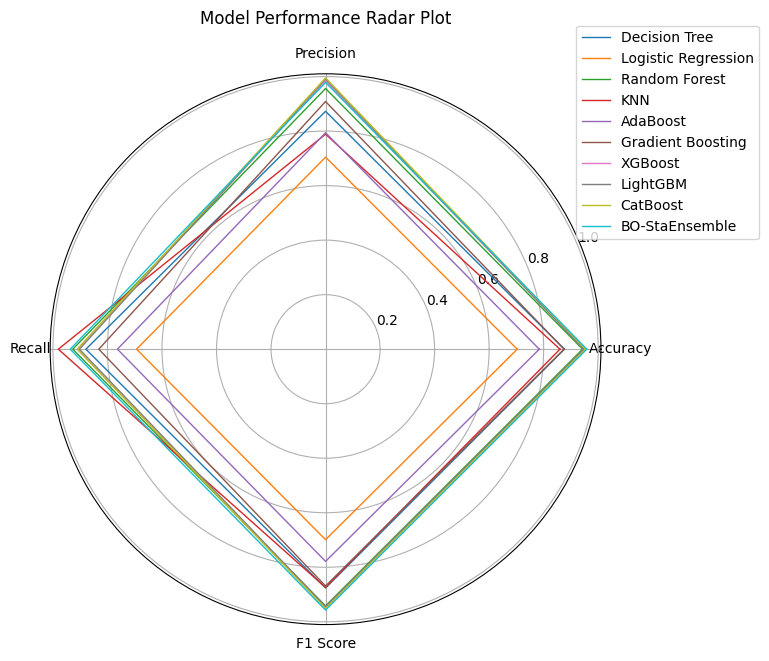

In [ ]:
from sklearn.metrics import accuracy_score, f1_score
from math import pi

# Collect metrics
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
radar_data = []

for name in model_names:
    y_pred = model_preds[name]
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    radar_data.append([acc, prec, rec, f1])

# Radar plot setup
categories = metrics
N = len(categories)

plt.figure(figsize=(8, 15))
for i, scores in enumerate(radar_data):
    values = scores + [scores[0]]
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.polar(angles, values, label=model_names[i], linewidth=1)

plt.xticks([n / float(N) * 2 * pi for n in range(N)], categories)
plt.title('Model Performance Radar Plot\n\n')
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


t-SNE

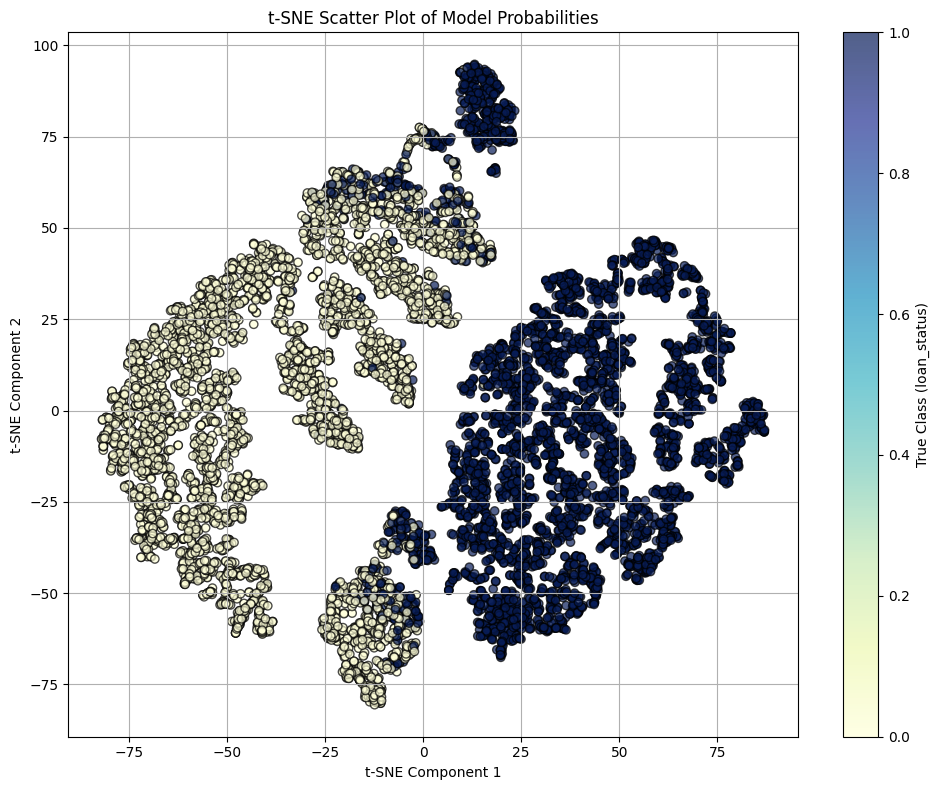

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Collect model predicted probabilities (if available)
model_probs = {}
for name, model in models.items():
    if hasattr(model, "predict_proba"):
        model_probs[name] = model.predict_proba(X_test)[:, 1]
    else:
        model_probs[name] = model.decision_function(X_test)  # fallback for SVM

# Include BO-StaEnsemble
model_probs['BO-StaEnsemble'] = y_proba  # from BO model

# Create dataframe for PCA input
probs_df = pd.DataFrame(model_probs)
probs_scaled = StandardScaler().fit_transform(probs_df)
# t-SNE (takes longer than PCA)
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
tsne_components = tsne.fit_transform(probs_scaled)

# Plot
plt.figure(figsize=(10, 8))
scatter = plt.scatter(tsne_components[:, 0], tsne_components[:, 1],
                      c=y_test, cmap='YlGnBu', alpha=0.7, edgecolor='k')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE Scatter Plot of Model Probabilities')
plt.colorbar(scatter, label='True Class (loan_status)')
plt.grid(True)
plt.tight_layout()
plt.show()


Explainable AI (XAI)

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Initialize LIME explainer
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X.values,
    feature_names=X.columns,
    class_names=[str(c) for c in np.unique(y)],
    mode='classification'
)

# Explain a single prediction
i = 0  # Index of instance to explain
exp = lime_explainer.explain_instance(X.iloc[i].values, ensemble_predict_proba, num_features=11)

# Show explanation
exp.show_in_notebook(show_table=True)

100%|===================| 28625/28638 [02:02<00:00]       

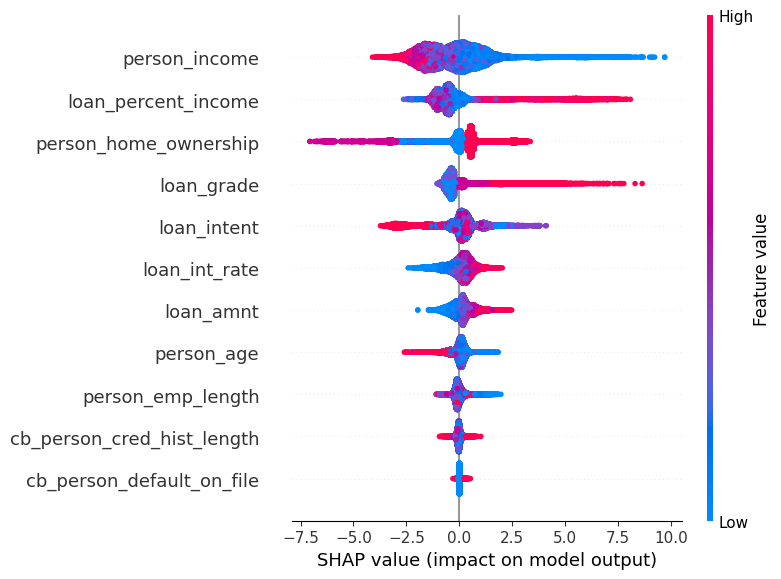

In [ ]:
# Train your model if not already trained
xgb_model = XGBClassifier()
xgb_model.fit(X, y)

# Initialize SHAP explainer
explainer = shap.Explainer(xgb_model, X)
shap_values = explainer(X)

# Summary Plot (feature importance)
shap.summary_plot(shap_values, X)

In [ ]:
pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 41.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 97.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 108.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 107.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 80.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.8/259.8 kB 22.0 MB/s eta 0:00:00
  Created wheel for dash-cytoscape: filename=dash_cytoscape-1.0.2-py3-none-any.whl size=4010717 sha256=aa0310d17f3b6a3f065a1b6be1c76e04e7d9114fb469cf1a7d25ef1ce4fc895b
 

In [ ]:
xgb_model = XGBClassifier(
    n_estimators=100,      # Number of boosting rounds
    max_depth=5,           # Maximum depth of a tree
    learning_rate=0.1,     # Step size shrinkage to prevent overfitting
    subsample=0.8,         # Subsample ratio of the training instance
    colsample_bytree=0.8,  # Subsample ratio of columns when constructing each tree
    use_label_encoder=False, # Suppress the UserWarning
    eval_metric='logloss', # Evaluation metric for objectiveloss (binary classification)
    random_state=42        # For reproducibility
)


# 2. Train the XGBoost Model
print("Training XGBoost model...")
xgb_model.fit(X_train, y_train)
print("XGBoost model training complete.")

from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret import show
from interpret.blackbox import MorrisSensitivity

# Remove the extraneous XGBClassifier() call
# XGBClassifier() # This line is not needed

print("\n--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---")

# Apply MorrisSensitivity directly to your trained xgb_best model and the original X_train data
msa = MorrisSensitivity(xgb_best, X_train)

# Generate and show the global explanation for the XGBoost model
show(msa.explain_global())

print("\nMorris Sensitivity Analysis on XGBoost with Interpret library complete.")

Training XGBoost model...
XGBoost model training complete.

--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---



Morris Sensitivity Analysis on XGBoost with Interpret library complete.


# Econometric Analysis

In [ ]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import ADASYN
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
import optuna
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, classification_report
)
from scipy.stats import ttest_rel, wilcoxon
import shap
import lime
import lime.lime_tabular
from SALib.sample import morris as morris_sample
from SALib.analyze import morris as morris_analyze


In [ ]:
# Load dataset
df = pd.read_csv('/content/Econometric Analysis.csv')
df.dropna(inplace=True)
df.head()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1319 entries, 0 to 1318
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   card         1319 non-null   object 
 1   reports      1319 non-null   int64  
 2   age          1319 non-null   float64
 3   income       1319 non-null   float64
 4   share        1319 non-null   float64
 5   expenditure  1319 non-null   float64
 6   owner        1319 non-null   object 
 7   selfemp      1319 non-null   object 
 8   dependents   1319 non-null   int64  
 9   months       1319 non-null   int64  
 10  majorcards   1319 non-null   int64  
 11  active       1319 non-null   int64  
dtypes: float64(4), int64(5), object(3)
memory usage: 123.8+ KB


In [ ]:
df.head()

,card,reports,age,income,share,expenditure,owner,selfemp,dependents,months,majorcards,active
0,yes,0,37.66667,4.5200,0.033270,124.983300,yes,no,3,54,1,12
1,yes,0,33.25000,2.4200,0.005217,9.854167,no,no,3,34,1,13
2,yes,0,33.66667,4.5000,0.004156,15.000000,yes,no,4,58,1,5
3,yes,0,30.50000,2.5400,0.065214,137.869200,no,no,0,25,1,7
4,yes,0,32.16667,9.7867,0.067051,546.503300,yes,no,2,64,1,5


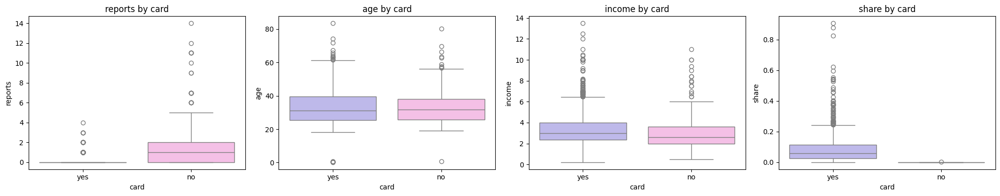

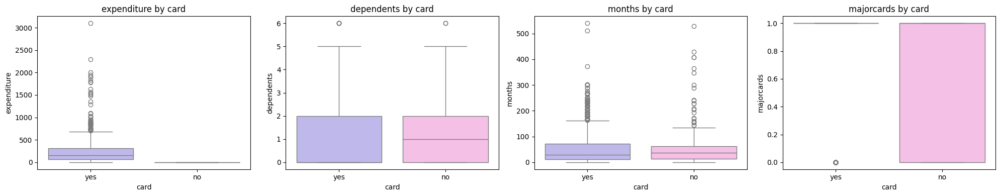

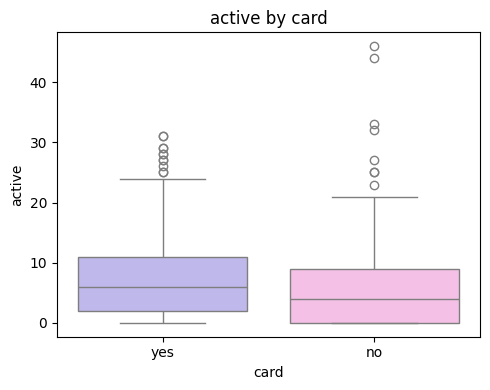

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define custom colors for the two categories in loan_status
custom_palette = {"yes": "#B7B1F2", "no": "#FDB7EA"}  # Blue and Orange

numeric_cols = df.select_dtypes(include='number').columns.tolist()

def plot_box_plots(df, columns, target='card', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.boxplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_box_plots(df, numeric_cols)


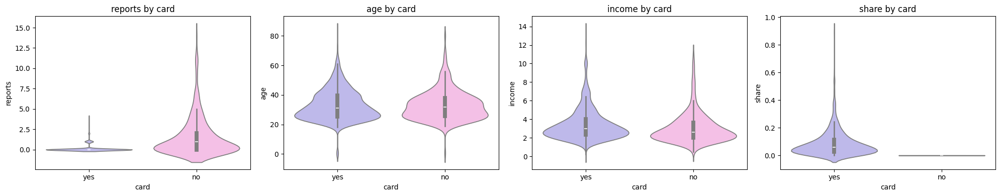

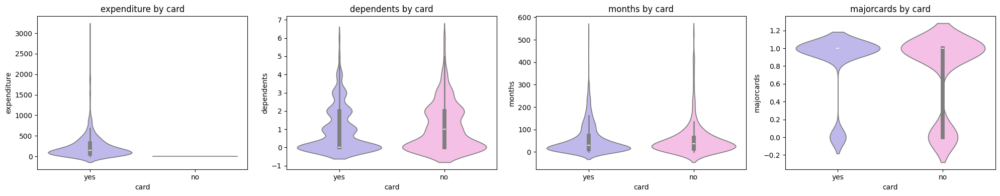

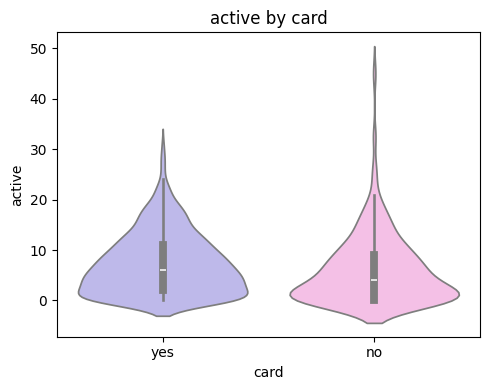

In [ ]:
def plot_violin_plots(df, columns, target='card', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.violinplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_violin_plots(df, numeric_cols)

In [ ]:

target = 'card'

numeric_features = [
    'reports', 'age', 'income', 'share', 'expenditure', 'dependents', 'months', 'majorcards', 'active'
]

categorical_features = [
    'owner', 'selfemp', 'card'
]

# ----------------------
# 1. Label Encode Categorical Features
# ----------------------
label_encoders = {}
for col in categorical_features:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

# ----------------------
# 2. Normalize Numeric Features
# ----------------------
scaler = StandardScaler()
df[numeric_features] = scaler.fit_transform(df[numeric_features])

# ----------------------
# 3. Print Processed Data
# ----------------------
print("\nPreprocessed Dataset:")
df.head()

# Optional: Separate features and label for model input
X = df.drop(columns=[target])
y = df[target]


Preprocessed Dataset:


In [ ]:
df.head()

,card,reports,age,income,share,expenditure,owner,selfemp,dependents,months,majorcards,active
0,1,-0.339397,0.439254,0.681894,-0.374787,-0.220766,1,0,1.608362,-0.019135,0.472824,0.793701
1,1,-0.339397,0.003639,-0.558317,-0.671269,-0.643854,0,0,1.608362,-0.321037,0.472824,0.952345
2,1,-0.339397,0.044735,0.670083,-0.682486,-0.624944,1,0,2.410112,0.041245,0.472824,-0.316807
3,1,-0.339397,-0.267592,-0.487448,-0.037185,-0.173411,0,0,-0.796887,-0.456893,0.472824,0.000481
4,1,-0.339397,-0.103209,3.792286,-0.017772,1.328281,1,0,0.806613,0.131816,0.472824,-0.316807


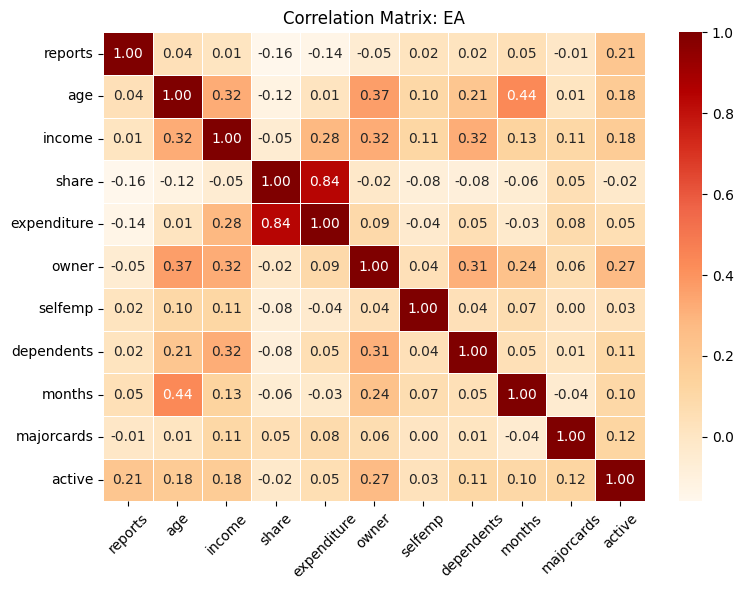

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Drop the target column
df_corr = df.drop(columns=['card'])
df_corr_numeric = df_corr.select_dtypes(include=['float64', 'int64'])
corr_matrix = df_corr_numeric.corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap="OrRd", fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix: EA')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

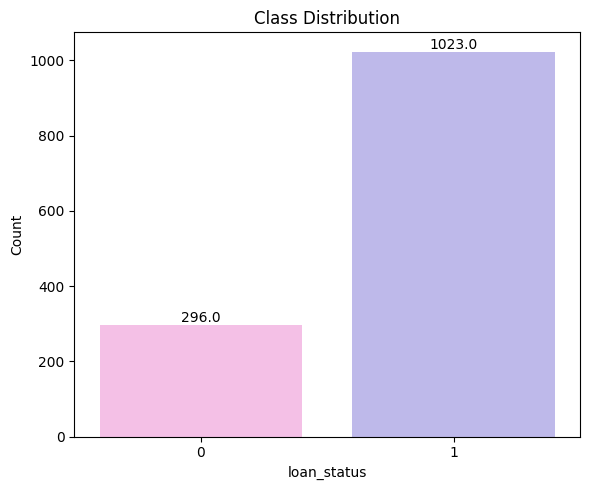

In [ ]:
plt.figure(figsize=(6, 5))
ax = sns.countplot(x='card', data=df, palette=[ "#FDB7EA", "#B7B1F2"])
plt.title("Class Distribution")
plt.xlabel("loan_status")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()

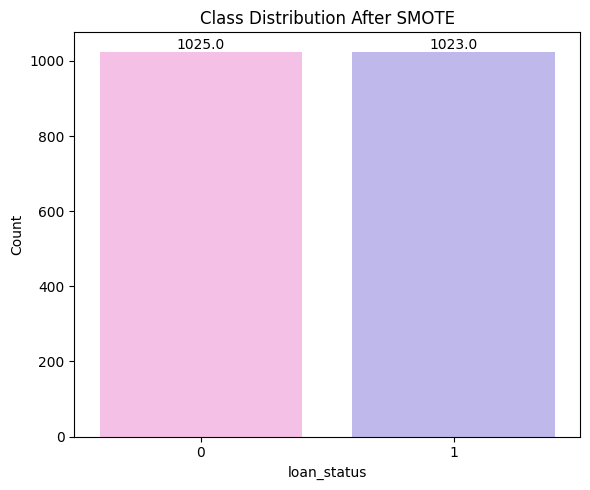


🔍 Model: Decision Tree
              precision    recall  f1-score   support

           0     0.9950    0.9805    0.9877       205
           1     0.9808    0.9951    0.9879       205

    accuracy                         0.9878       410
   macro avg     0.9879    0.9878    0.9878       410
weighted avg     0.9879    0.9878    0.9878       410

Sensitivity (Recall): 0.9951
Specificity: 0.9805
Matthews Correlation Coefficient (MCC): 0.9757
Cohen's Kappa: 0.9756

🔍 Model: Logistic Regression
              precision    recall  f1-score   support

           0     0.9227    0.9902    0.9553       205
           1     0.9895    0.9171    0.9519       205

    accuracy                         0.9537       410
   macro avg     0.9561    0.9537    0.9536       410
weighted avg     0.9561    0.9537    0.9536       410

Sensitivity (Recall): 0.9171
Specificity: 0.9902
Matthews Correlation Coefficient (MCC): 0.9098
Cohen's Kappa: 0.9073

🔍 Model: Random Forest
              precision    recal

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    make_scorer, matthews_corrcoef, cohen_kappa_score
)
from imblearn.over_sampling import ADASYN

# ML Models
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier


# Apply ADASYN
adasyn = ADASYN(random_state=42)
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Plot class distribution
plt.figure(figsize=(6, 5))
ax = sns.countplot(x=y_resampled, palette=["#FDB7EA", "#B7B1F2"])
plt.title("Class Distribution After SMOTE")
plt.xlabel("loan_status")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()


# ------------- Train/Test Split ---------------- #
X_train, X_test, y_train, y_test = train_test_split(
    X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled
)

# ------------- Models Dictionary ---------------- #
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'KNN': KNeighborsClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
    'LightGBM': LGBMClassifier(),
    'CatBoost': CatBoostClassifier(verbose=0)
}

# ------------- Evaluation ---------------- #
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()
    sensitivity = recall_score(y_test, y_pred)  # TP / (TP + FN)
    specificity = TN / (TN + FP)
    mcc = matthews_corrcoef(y_test, y_pred)
    kappa = cohen_kappa_score(y_test, y_pred)

    print(f"\n🔍 Model: {name}")
    print(classification_report(y_test, y_pred, digits=4))
    print(f"Sensitivity (Recall): {sensitivity:.4f}")
    print(f"Specificity: {specificity:.4f}")
    print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
    print(f"Cohen's Kappa: {kappa:.4f}")

<Figure size 1000x800 with 0 Axes>

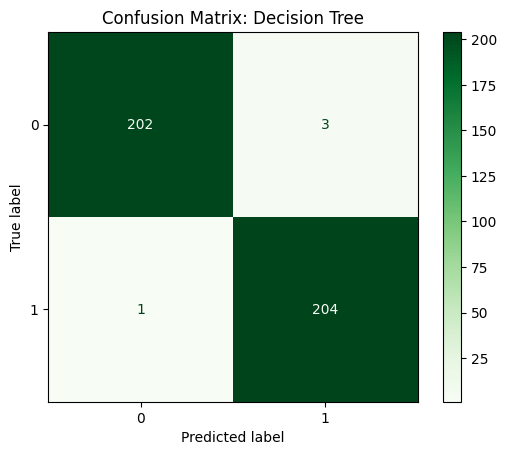

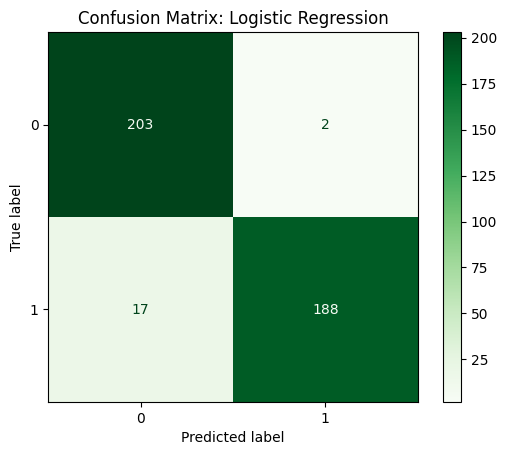

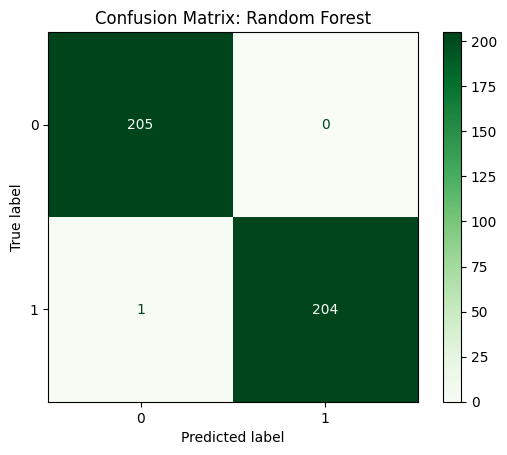

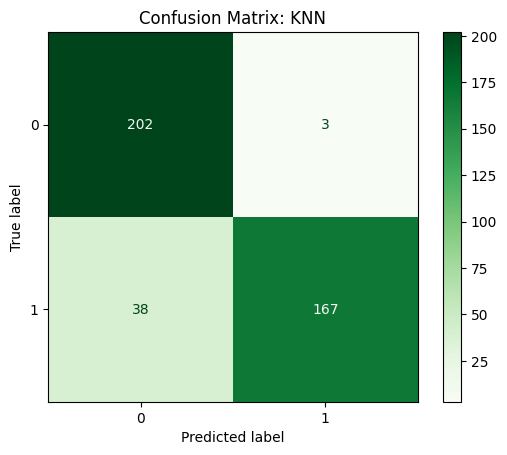

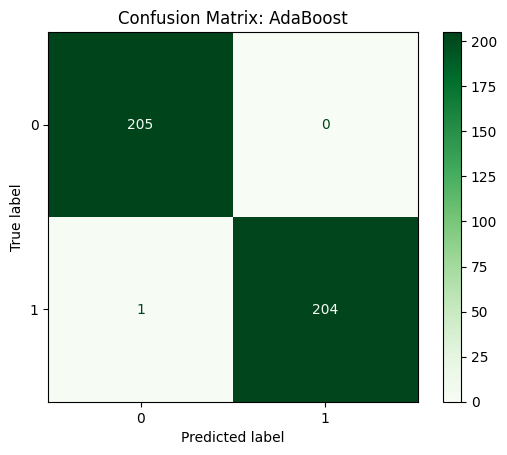

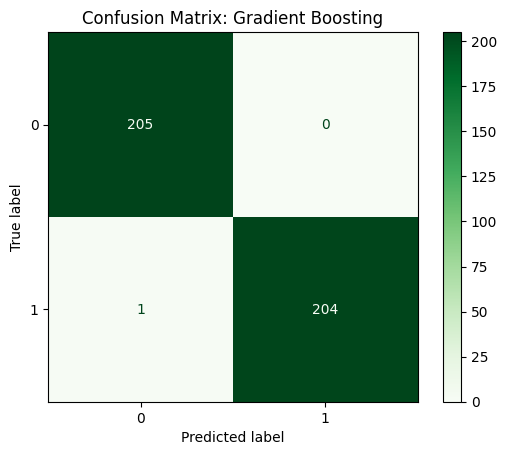

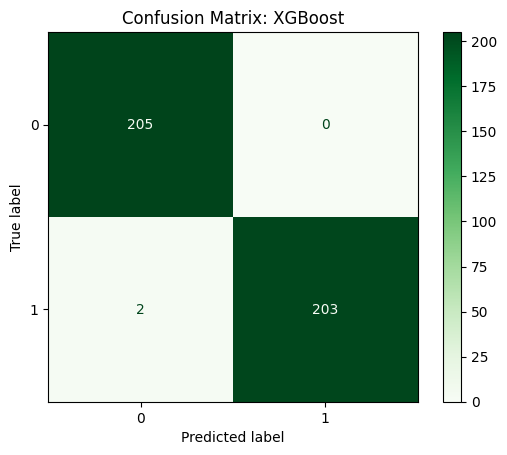

[LightGBM] [Info] Number of positive: 818, number of negative: 820
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1701
[LightGBM] [Info] Number of data points in the train set: 1638, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499389 -> initscore=-0.002442
[LightGBM] [Info] Start training from score -0.002442
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

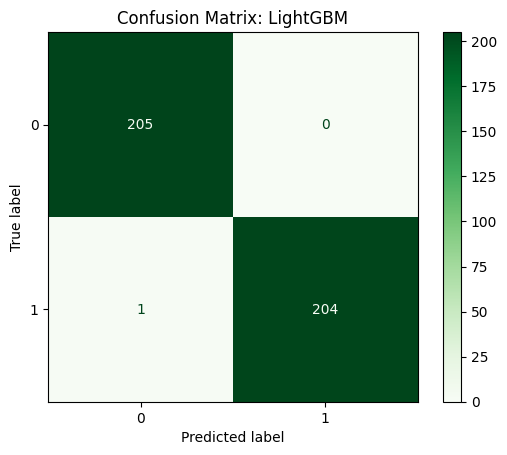

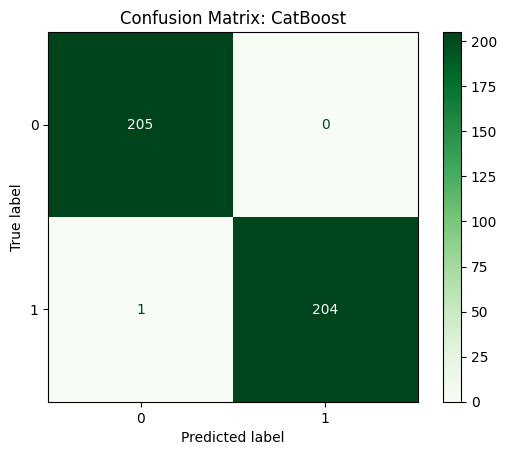

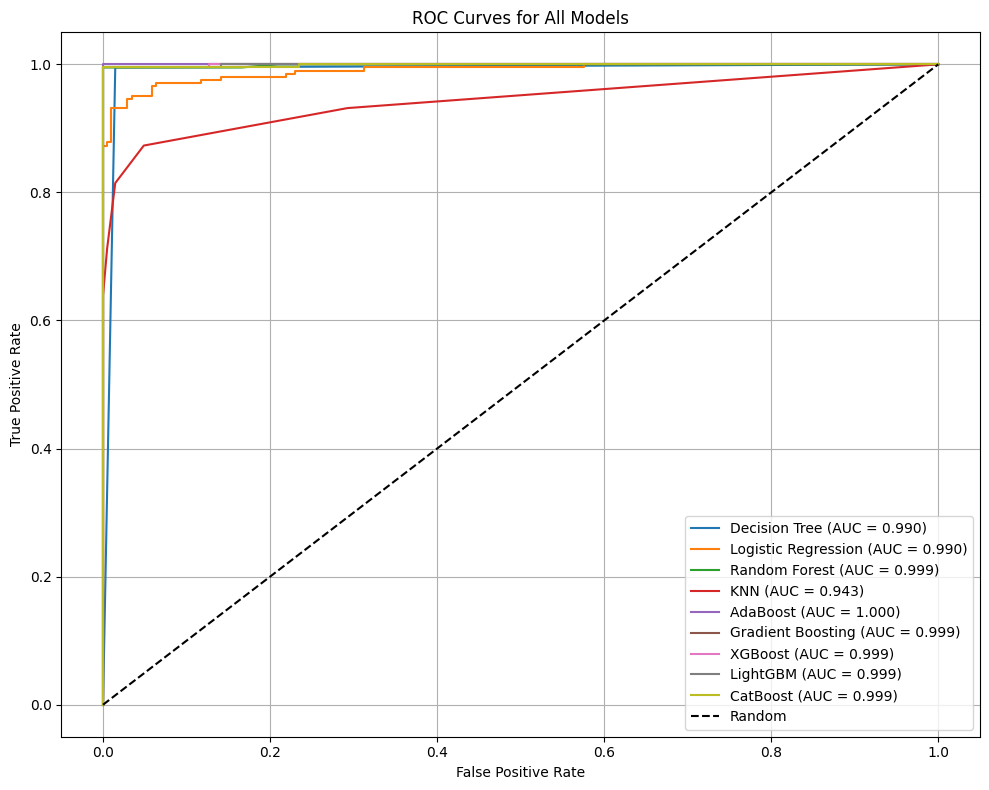

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay, roc_curve, auc
import matplotlib.pyplot as plt

# Store ROC data
plt.figure(figsize=(10, 8))
roc_data = {}

for name, model in models.items():
    # Fit model and predict
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # --- Plot Confusion Matrix ---
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(cmap='Greens')
    plt.title(f"Confusion Matrix: {name}")
    plt.show()

    # --- Calculate ROC Curve ---
    if hasattr(model, "predict_proba"):
        y_score = model.predict_proba(X_test)[:, 1]
    else:
        y_score = model.decision_function(X_test)

    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    roc_data[name] = (fpr, tpr, roc_auc)

# --- Plot All ROC Curves Together ---
plt.figure(figsize=(10, 8))
for name, (fpr, tpr, roc_auc) in roc_data.items():
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.3f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for All Models')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()


[I 2025-06-19 23:12:29,475] A new study created in memory with name: no-name-ba53f911-b732-4381-b567-f7f963a0f803
[I 2025-06-19 23:12:33,031] Trial 0 finished with value: 0.9857936998147004 and parameters: {'rf_n_estimators': 259, 'rf_max_depth': 13, 'rf_min_samples_split': 6, 'xgb_n_estimators': 119, 'xgb_max_depth': 12, 'xgb_learning_rate': 0.10424334542849126, 'xgb_subsample': 0.6534509411275886, 'xgb_colsample_bytree': 0.9742314392543518, 'lr_C': 0.17291304355491752, 'meta_C': 4.206737142469376}. Best is trial 0 with value: 0.9857936998147004.
[I 2025-06-19 23:12:34,641] Trial 1 finished with value: 0.9863692688971499 and parameters: {'rf_n_estimators': 93, 'rf_max_depth': 11, 'rf_min_samples_split': 5, 'xgb_n_estimators': 66, 'xgb_max_depth': 6, 'xgb_learning_rate': 0.07978963278600947, 'xgb_subsample': 0.7561137977800931, 'xgb_colsample_bytree': 0.8407261950040135, 'lr_C': 0.02524185531119038, 'meta_C': 0.1931450188700845}. Best is trial 1 with value: 0.9863692688971499.
[I 2025-

Best hyperparameters:
{'rf_n_estimators': 93, 'rf_max_depth': 11, 'rf_min_samples_split': 5, 'xgb_n_estimators': 66, 'xgb_max_depth': 6, 'xgb_learning_rate': 0.07978963278600947, 'xgb_subsample': 0.7561137977800931, 'xgb_colsample_bytree': 0.8407261950040135, 'lr_C': 0.02524185531119038, 'meta_C': 0.1931450188700845}

 BO-StaEnsemble Model Evaluation:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       205
           1       1.00      0.99      1.00       205

    accuracy                           1.00       410
   macro avg       1.00      1.00      1.00       410
weighted avg       1.00      1.00      1.00       410

Sensitivity (Recall): 0.9902
Specificity: 1.0000
Matthews Correlation Coefficient (MCC): 0.9903
Cohen's Kappa: 0.9902


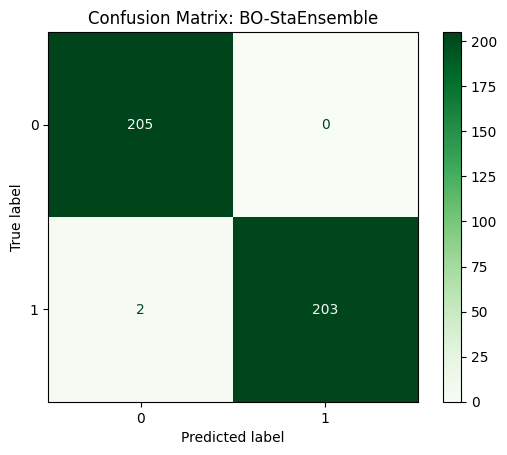

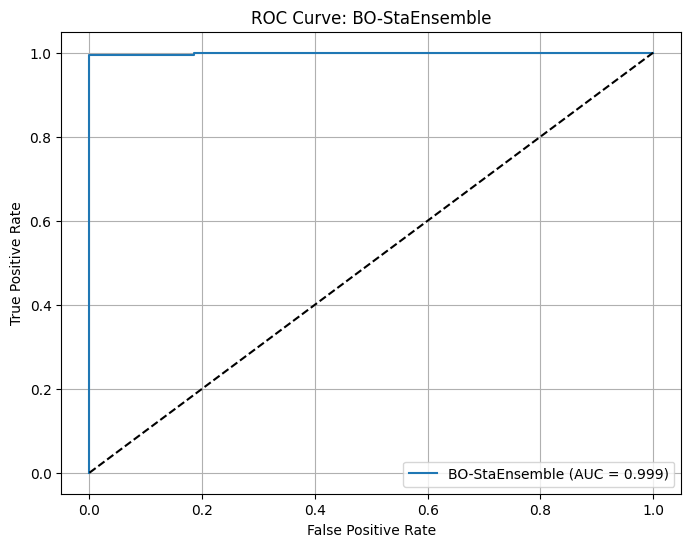

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    matthews_corrcoef, cohen_kappa_score, roc_curve, auc, ConfusionMatrixDisplay
)
from sklearn.model_selection import StratifiedKFold
import optuna
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier

# Assume X_train, y_train, X_test, y_test are already defined (preprocessed and split)

# Base learners creation functions
def create_rf(trial):
    return RandomForestClassifier(
        n_estimators=trial.suggest_int('rf_n_estimators', 50, 300),
        max_depth=trial.suggest_int('rf_max_depth', 3, 20),
        min_samples_split=trial.suggest_int('rf_min_samples_split', 2, 10),
        random_state=42
    )

def create_xgb(trial):
    return XGBClassifier(
        n_estimators=trial.suggest_int('xgb_n_estimators', 50, 300),
        max_depth=trial.suggest_int('xgb_max_depth', 3, 20),
        learning_rate=trial.suggest_float('xgb_learning_rate', 0.01, 0.3),
        subsample=trial.suggest_float('xgb_subsample', 0.5, 1.0),
        colsample_bytree=trial.suggest_float('xgb_colsample_bytree', 0.5, 1.0),
        use_label_encoder=False,
        eval_metric='logloss',
        random_state=42
    )

def create_lr(trial):
    return LogisticRegression(
        C=trial.suggest_float('lr_C', 0.01, 10.0, log=True),
        max_iter=1000,
        solver='lbfgs',
        random_state=42
    )

base_learners = ['rf', 'xgb', 'lr']

# Generate out-of-fold predictions for stacking meta-features
def stacking_oof_preds(X, y, trial, n_splits=5):
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    oof_preds = {learner: np.zeros(len(y)) for learner in base_learners}

    for train_idx, val_idx in skf.split(X, y):
        X_train_fold, X_val_fold = X.iloc[train_idx], X.iloc[val_idx]
        y_train_fold = y.iloc[train_idx]

        rf = create_rf(trial)
        rf.fit(X_train_fold, y_train_fold)
        oof_preds['rf'][val_idx] = rf.predict_proba(X_val_fold)[:,1]

        xgb = create_xgb(trial)
        xgb.fit(X_train_fold, y_train_fold)
        oof_preds['xgb'][val_idx] = xgb.predict_proba(X_val_fold)[:,1]

        lr = create_lr(trial)
        lr.fit(X_train_fold, y_train_fold)
        oof_preds['lr'][val_idx] = lr.predict_proba(X_val_fold)[:,1]

    meta_features = np.column_stack([oof_preds[learner] for learner in base_learners])
    return meta_features

# Objective function for Optuna
def objective(trial):
    meta_X = stacking_oof_preds(X_train, y_train, trial)

    meta_C = trial.suggest_float('meta_C', 0.01, 10.0, log=True)
    meta_model = LogisticRegression(C=meta_C, max_iter=1000, random_state=42)

    meta_model.fit(meta_X, y_train)
    preds = meta_model.predict(meta_X)
    return f1_score(y_train, preds)

# Run the optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)

print("Best hyperparameters:")
print(study.best_trial.params)

# Retrain base learners on full training set with best params
best_params = study.best_trial.params

rf_best = RandomForestClassifier(
    n_estimators=best_params['rf_n_estimators'],
    max_depth=best_params['rf_max_depth'],
    min_samples_split=best_params['rf_min_samples_split'],
    random_state=42
)
xgb_best = XGBClassifier(
    n_estimators=best_params['xgb_n_estimators'],
    max_depth=best_params['xgb_max_depth'],
    learning_rate=best_params['xgb_learning_rate'],
    subsample=best_params['xgb_subsample'],
    colsample_bytree=best_params['xgb_colsample_bytree'],
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)
lr_best = LogisticRegression(
    C=best_params['lr_C'],
    max_iter=1000,
    solver='lbfgs',
    random_state=42
)

# Fit base learners on full training set
rf_best.fit(X_train, y_train)
xgb_best.fit(X_train, y_train)
lr_best.fit(X_train, y_train)

# Create meta features for train and test
def create_meta_features(models, X):
    meta_features = np.column_stack([
        model.predict_proba(X)[:,1] for model in models
    ])
    return meta_features

base_models = [rf_best, xgb_best, lr_best]

meta_X_train = create_meta_features(base_models, X_train)
meta_X_test = create_meta_features(base_models, X_test)

# Train meta learner with best meta_C
meta_model = LogisticRegression(C=best_params['meta_C'], max_iter=1000, random_state=42)
meta_model.fit(meta_X_train, y_train)

# Final predictions
y_pred = meta_model.predict(meta_X_test)
y_proba = meta_model.predict_proba(meta_X_test)[:,1]

# Evaluation metrics
cm = confusion_matrix(y_test, y_pred)
TN, FP, FN, TP = cm.ravel()
sensitivity = recall_score(y_test, y_pred)  # Recall
specificity = TN / (TN + FP)
mcc = matthews_corrcoef(y_test, y_pred)
kappa = cohen_kappa_score(y_test, y_pred)

print("\n BO-StaEnsemble Model Evaluation:")
print(classification_report(y_test, y_pred))
print(f"Sensitivity (Recall): {sensitivity:.4f}")
print(f"Specificity: {specificity:.4f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
print(f"Cohen's Kappa: {kappa:.4f}")

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap='Greens')
plt.title("Confusion Matrix: BO-StaEnsemble")
plt.show()

# Plot ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, label=f'BO-StaEnsemble (AUC = {roc_auc:.3f})')
plt.plot([0,1], [0,1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve: BO-StaEnsemble')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


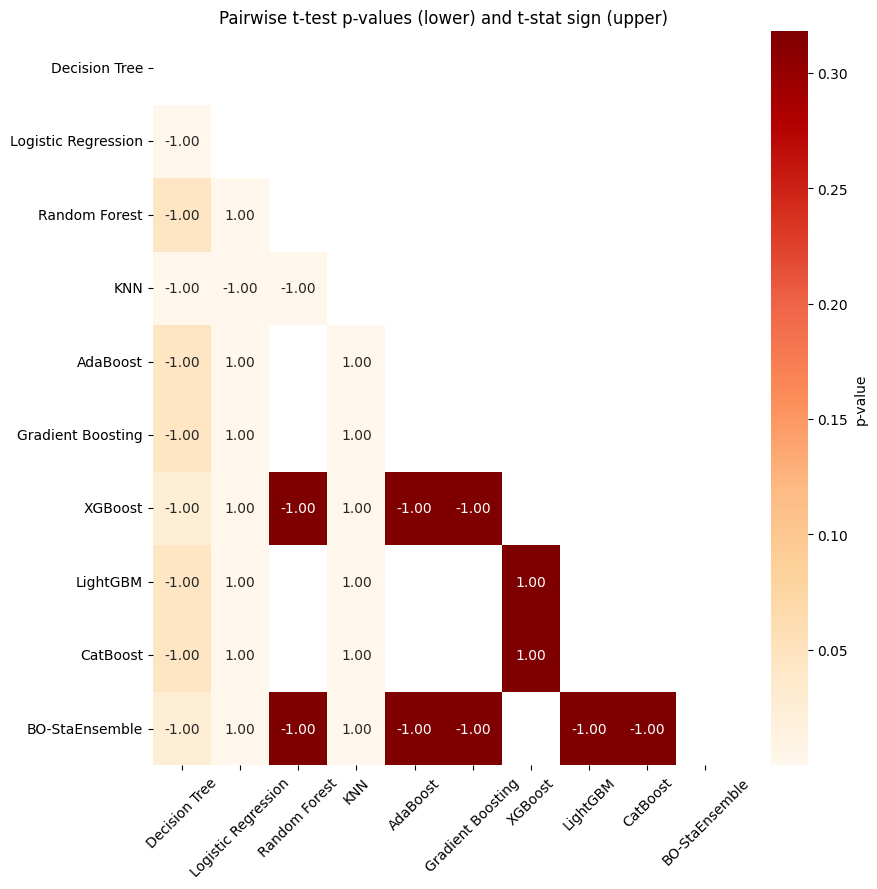

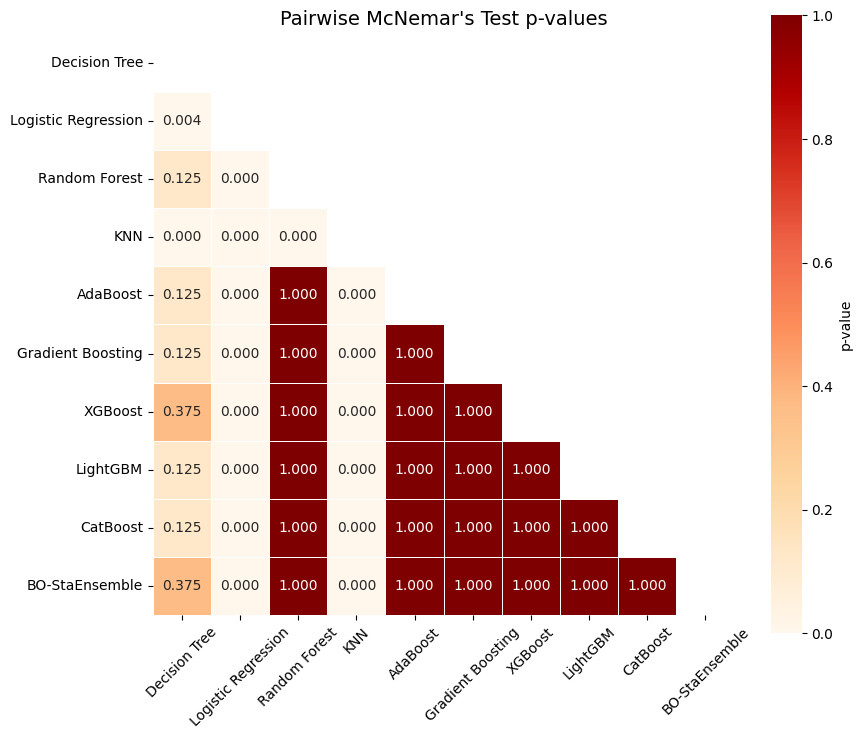

In [ ]:
from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Store predictions from trained models
model_preds = {}
for name, model in models.items():
    model_preds[name] = model.predict(X_test)

# Add BO-StaEnsemble prediction manually (assuming already available)
model_preds['BO-StaEnsemble'] = y_pred  # y_pred from BO-StaEnsemble

from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

model_names = list(model_preds.keys())
n_models = len(model_names)

# Initialize matrices
t_stat_matrix = np.zeros((n_models, n_models))
p_val_matrix = np.zeros((n_models, n_models))
mcnemar_p_matrix = np.ones((n_models, n_models))

# Run tests
for i in range(n_models):
    for j in range(n_models):
        if i == j:
            continue
        pred_i = model_preds[model_names[i]]
        pred_j = model_preds[model_names[j]]

        # Paired t-test
        t_stat, p_val = ttest_rel(pred_i, pred_j)
        t_stat_matrix[i, j] = np.sign(t_stat)
        p_val_matrix[i, j] = p_val

        # McNemar's Test
        b = np.logical_and(pred_i == y_test, pred_j != y_test).sum()
        c = np.logical_and(pred_i != y_test, pred_j == y_test).sum()
        table = np.array([[0, b], [c, 0]])
        try:
            result = mcnemar(table, exact=True)
            mcnemar_p_matrix[i, j] = result.pvalue
        except:
            mcnemar_p_matrix[i, j] = np.nan

# Convert to DataFrames
t_stat_df = pd.DataFrame(t_stat_matrix, index=model_names, columns=model_names)
p_val_df = pd.DataFrame(p_val_matrix, index=model_names, columns=model_names)
mcnemar_p_df = pd.DataFrame(mcnemar_p_matrix, index=model_names, columns=model_names)

# Heatmap: t-test p-values & signs
plt.figure(figsize=(9, 9))
sns.heatmap(p_val_df, annot=t_stat_df, fmt='.2f', cmap='OrRd',
            mask=np.triu(np.ones_like(p_val_df, dtype=bool)),
            cbar_kws={'label': 'p-value'})
plt.title('Pairwise t-test p-values (lower) and t-stat sign (upper)')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


# Heatmap: McNemar's p-values (Lower Triangle Only)
mask = np.triu(np.ones_like(mcnemar_p_df, dtype=bool))  # Upper triangle mask

plt.figure(figsize=(9, 9))
sns.heatmap(mcnemar_p_df, annot=True, fmt=".3f", cmap="OrRd",
            mask=mask, linewidths=0.5, square=True,
            cbar_kws={"label": "p-value", "shrink": .75})
plt.title("Pairwise McNemar's Test p-values", fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

In [ ]:
# Print Pairwise t-test p-values (Lower Triangle Only)
print("📌 Pairwise t-test p-values (lower triangle):\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {p_val_matrix[i, j]:.4f}")
print("\n")

# Print Pairwise t-statistic signs (Upper Triangle Only)
print("📌 Pairwise t-test t-statistic sign (upper triangle):\n")
for i in range(n_models):
    for j in range(i+1, n_models):
        sign = "+" if t_stat_matrix[i, j] > 0 else "-" if t_stat_matrix[i, j] < 0 else "0"
        print(f"{model_names[i]} vs {model_names[j]}: t-sign = {sign}")
print("\n")

# Print Pairwise McNemar's Test p-values
print("📌 Pairwise McNemar's Test p-values:\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {mcnemar_p_matrix[i, j]:.4f}")


📌 Pairwise t-test p-values (lower triangle):

Logistic Regression vs Decision Tree: p-value = 0.0002
Random Forest vs Decision Tree: p-value = 0.0833
Random Forest vs Logistic Regression: p-value = 0.0009
KNN vs Decision Tree: p-value = 0.0000
KNN vs Logistic Regression: p-value = 0.0008
KNN vs Random Forest: p-value = 0.0000
AdaBoost vs Decision Tree: p-value = 0.0833
AdaBoost vs Logistic Regression: p-value = 0.0009
AdaBoost vs Random Forest: p-value = nan
AdaBoost vs KNN: p-value = 0.0000
Gradient Boosting vs Decision Tree: p-value = 0.0833
Gradient Boosting vs Logistic Regression: p-value = 0.0009
Gradient Boosting vs Random Forest: p-value = nan
Gradient Boosting vs KNN: p-value = 0.0000
Gradient Boosting vs AdaBoost: p-value = nan
XGBoost vs Decision Tree: p-value = 0.0454
XGBoost vs Logistic Regression: p-value = 0.0015
XGBoost vs Random Forest: p-value = 0.3179
XGBoost vs KNN: p-value = 0.0000
XGBoost vs AdaBoost: p-value = 0.3179
XGBoost vs Gradient Boosting: p-value = 0.3179


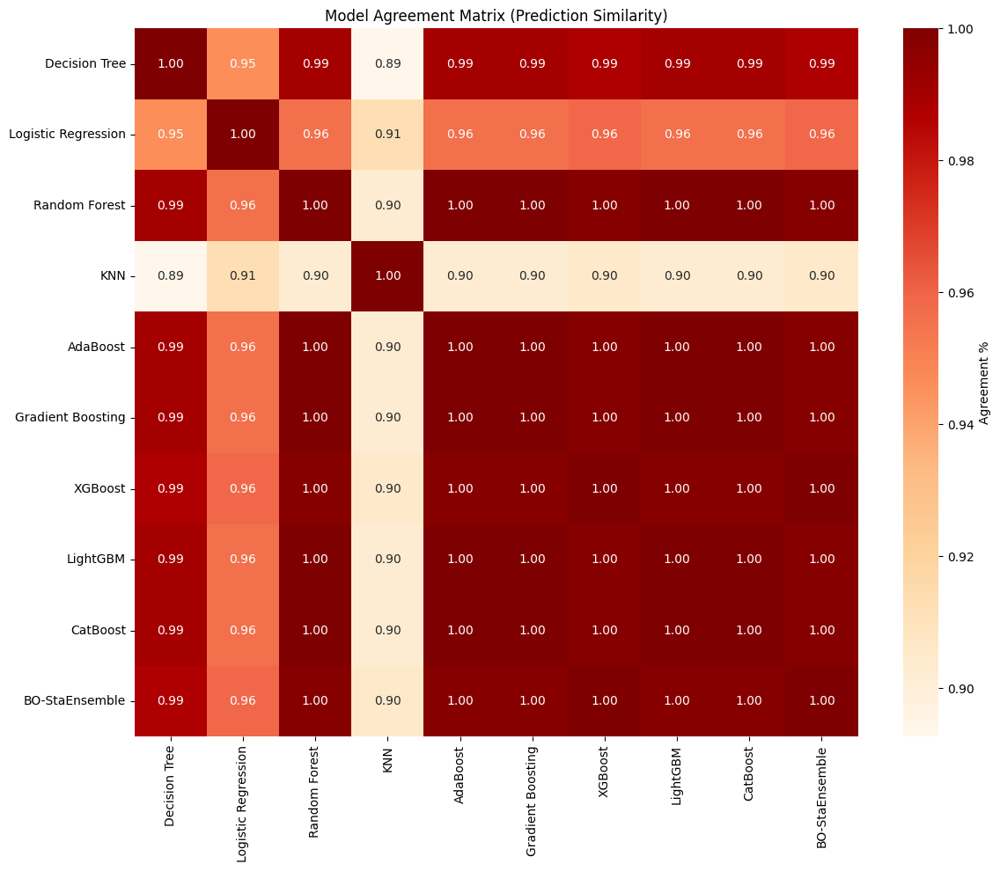

In [ ]:
# Agreement Matrix (percentage of same predictions between model pairs)
agreement_matrix = np.zeros((n_models, n_models))

for i in range(n_models):
    for j in range(n_models):
        agree = (model_preds[model_names[i]] == model_preds[model_names[j]]).mean()
        agreement_matrix[i, j] = agree

# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(agreement_matrix, annot=True, fmt=".2f", cmap="OrRd",
            xticklabels=model_names, yticklabels=model_names,
            cbar_kws={"label": "Agreement %"})
plt.title("Model Agreement Matrix (Prediction Similarity)")
plt.tight_layout()
plt.show()


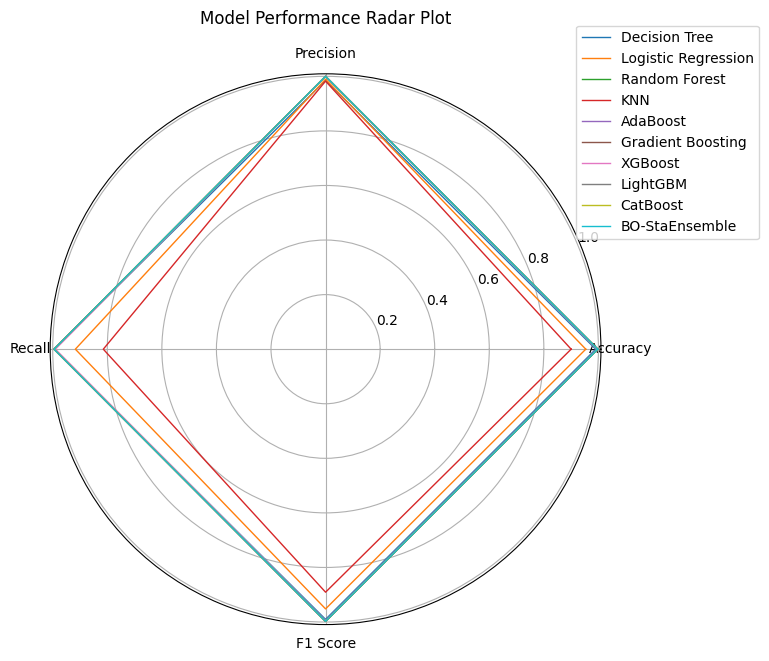

In [ ]:
from sklearn.metrics import accuracy_score, f1_score
from math import pi

# Collect metrics
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
radar_data = []

for name in model_names:
    y_pred = model_preds[name]
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    radar_data.append([acc, prec, rec, f1])

# Radar plot setup
categories = metrics
N = len(categories)

plt.figure(figsize=(8, 15))
for i, scores in enumerate(radar_data):
    values = scores + [scores[0]]
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.polar(angles, values, label=model_names[i], linewidth=1)

plt.xticks([n / float(N) * 2 * pi for n in range(N)], categories)
plt.title('Model Performance Radar Plot\n\n')
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


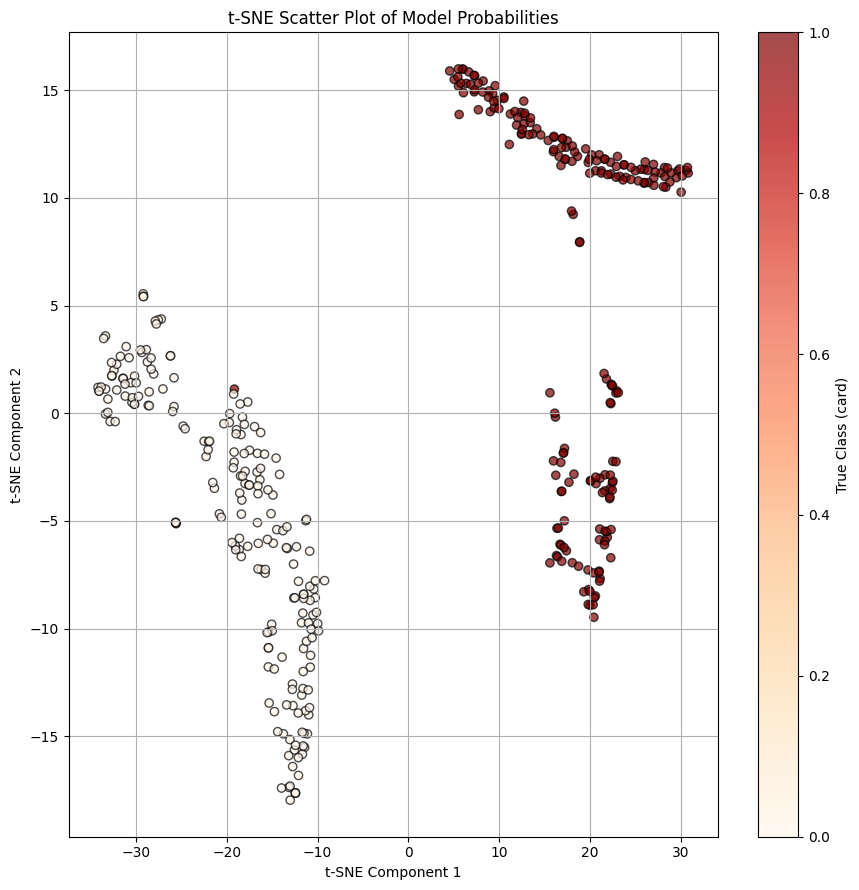

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Collect model predicted probabilities (if available)
model_probs = {}
for name, model in models.items():
    if hasattr(model, "predict_proba"):
        model_probs[name] = model.predict_proba(X_test)[:, 1]
    else:
        model_probs[name] = model.decision_function(X_test)  # fallback for SVM

# Include BO-StaEnsemble
model_probs['BO-StaEnsemble'] = y_proba  # from BO model

# Create dataframe for PCA input
probs_df = pd.DataFrame(model_probs)
probs_scaled = StandardScaler().fit_transform(probs_df)
# t-SNE (takes longer than PCA)
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
tsne_components = tsne.fit_transform(probs_scaled)

# Plot
plt.figure(figsize=(9, 9))
scatter = plt.scatter(tsne_components[:, 0], tsne_components[:, 1],
                      c=y_test, cmap='OrRd', alpha=0.7, edgecolor='k')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE Scatter Plot of Model Probabilities')
plt.colorbar(scatter, label='True Class (card)')
plt.grid(True)
plt.tight_layout()
plt.show()


Intercept 0.9626710689260674
Prediction_local [0.87981469]
Right: 0.0013897867


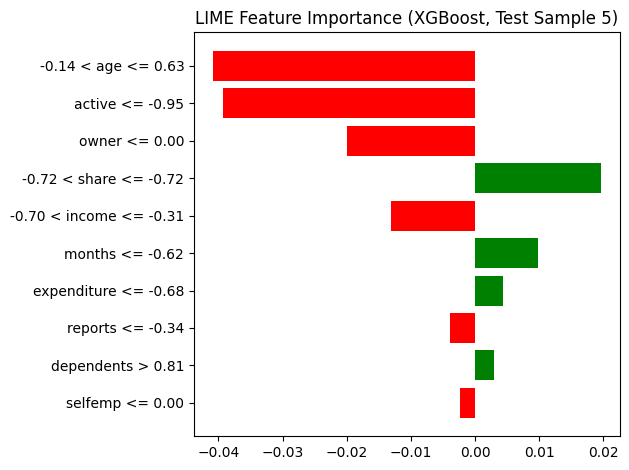

In [ ]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt

# LIME explainer for original input features
explainer_xgb = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns.tolist(),
    class_names=['Non-Default', 'Default'],
    mode='classification',
    verbose=True,
    random_state=42
)

# Choose one sample from the test set
i = 5  # change index as needed
exp = explainer_xgb.explain_instance(
    data_row=X_test.iloc[i].values,
    predict_fn=xgb_best.predict_proba,
    num_features=10  # top 10 features
)

# Show the explanation
exp.show_in_notebook(show_table=True)
fig = exp.as_pyplot_figure()
plt.title(f"LIME Feature Importance (XGBoost, Test Sample {i})")
plt.tight_layout()
plt.show()


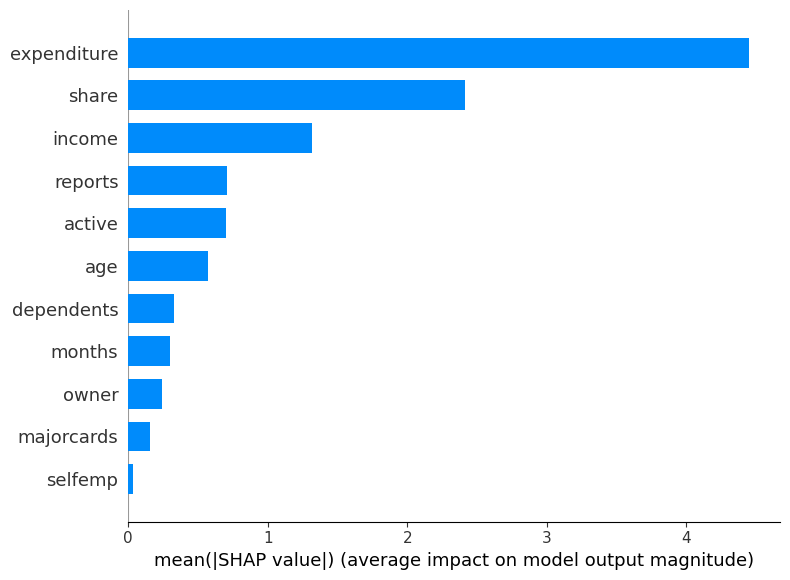

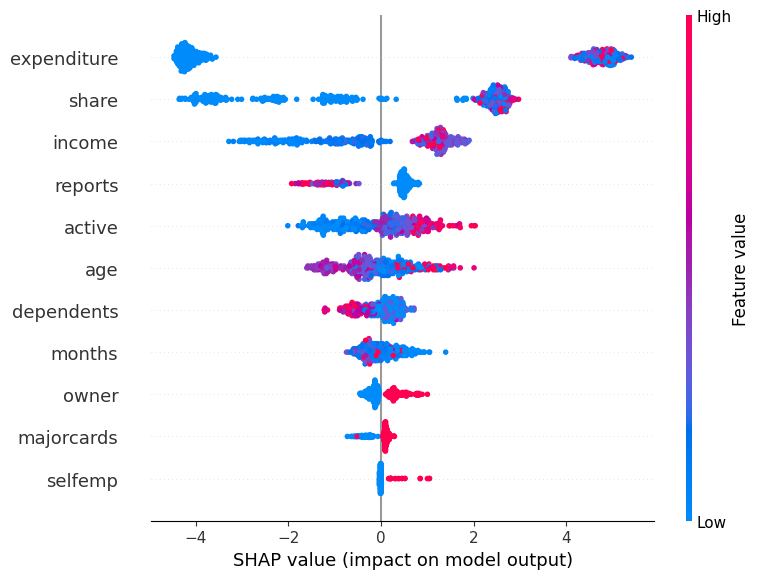

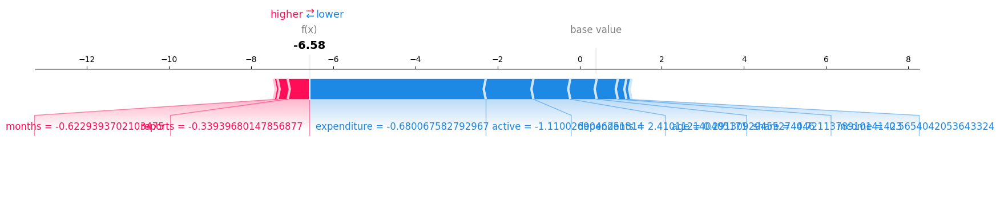

In [ ]:
import shap
import matplotlib.pyplot as plt

# Create SHAP explainer for XGBoost model
explainer = shap.Explainer(xgb_best, X_train)

# Calculate SHAP values for the test set
shap_values = explainer(X_test)

# Summary plot: global feature importance
shap.summary_plot(shap_values, X_test, plot_type="bar", show=True)

# Detailed beeswarm plot: direction & distribution
shap.summary_plot(shap_values, X_test, show=True)

# Force plot for a specific instance (optional)
i = 5  # sample index
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[i].values, X_test.iloc[i], matplotlib=True)


In [ ]:
pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 32.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 78.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 67.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 49.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 62.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 37.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.8/259.8 kB 18.9 MB/s eta 0:00:00
  Created wheel for dash-cytoscape: filename=dash_cytoscape-1.0.2-py3-none-any.whl size=4010717 sha256=6de9c83e3e977905b405f9064451b7db1f5696baa825157c640f6e8b055cfee2
  S

In [ ]:

from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret import show
from interpret.blackbox import MorrisSensitivity

# Remove the extraneous XGBClassifier() call
# XGBClassifier() # This line is not needed

print("\n--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---")

# Apply MorrisSensitivity directly to your trained xgb_best model and the original X_train data
msa = MorrisSensitivity(xgb_best, X_train)

# Generate and show the global explanation for the XGBoost model
show(msa.explain_global())


--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---


# Default of credit card clients (DCC)

In [ ]:
# Load dataset
df = pd.read_csv('/content/Default of Credit Card Clients.csv')
df.dropna(inplace=True)
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [ ]:
df = df.drop(columns=["ID"])

In [ ]:
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


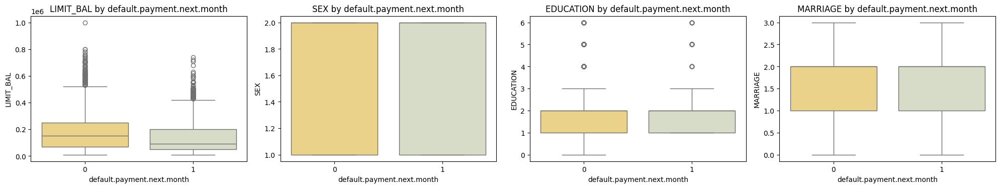

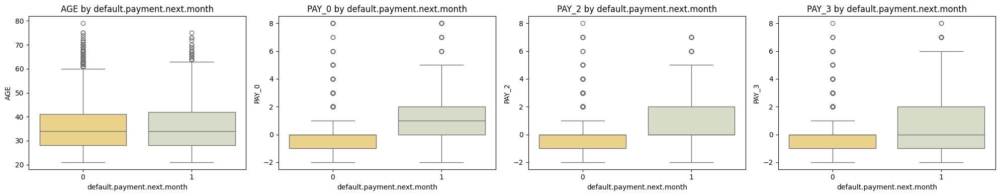

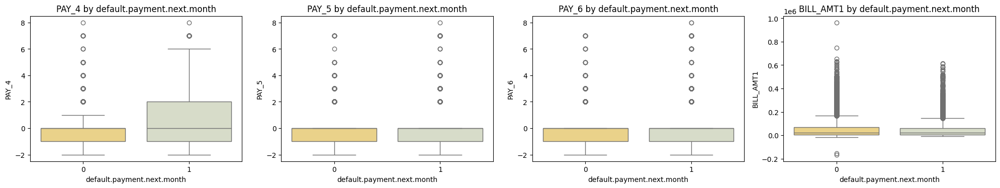

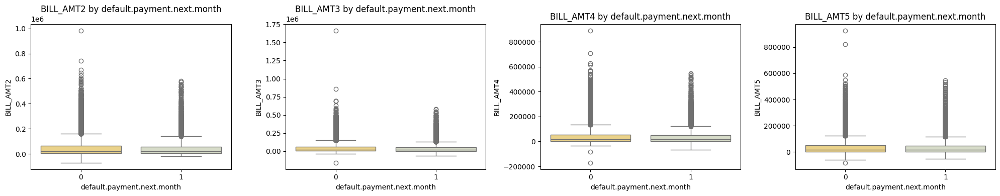

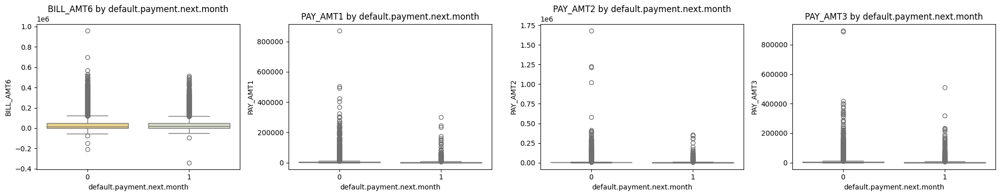

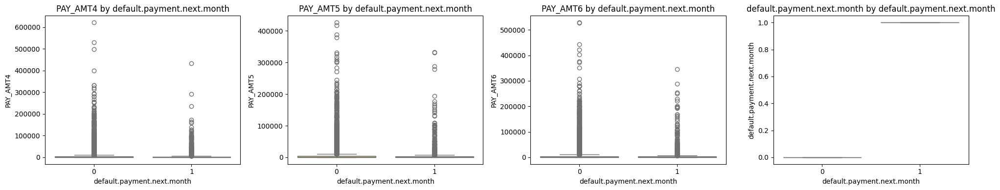

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define custom colors for the two categories in loan_status
custom_palette = {"1": "#D9DFC6", "0": "#FADA7A"}  # Blue and Orange

numeric_cols = df.select_dtypes(include='number').columns.tolist()

def plot_box_plots(df, columns, target='default.payment.next.month', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.boxplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_box_plots(df, numeric_cols)


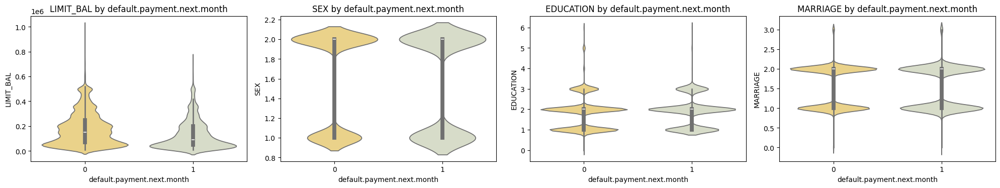

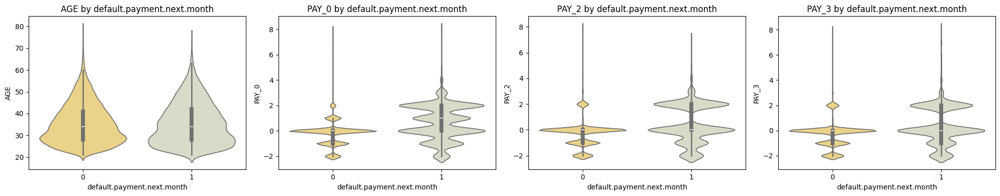

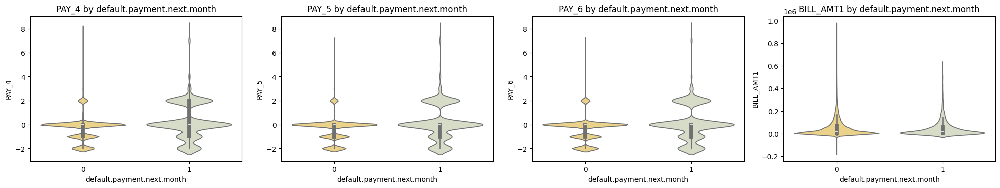

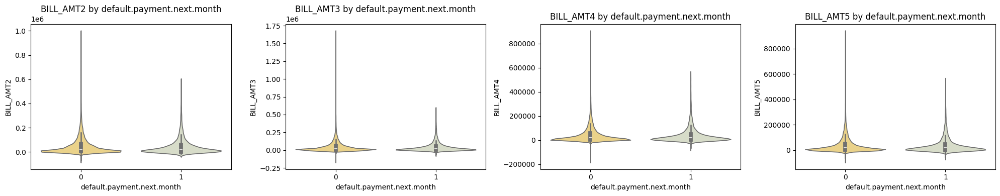

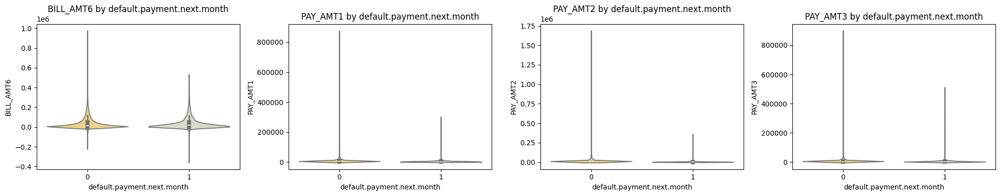

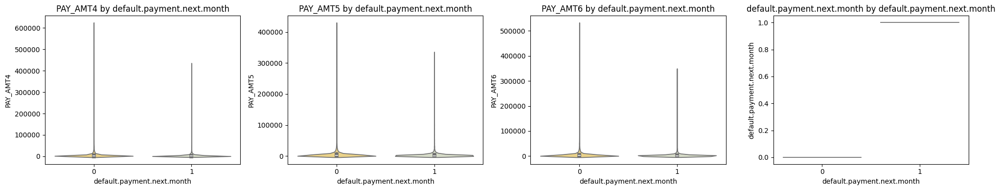

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define custom colors for the two categories in loan_status
custom_palette = {"1": "#D9DFC6", "0": "#FADA7A"}

def plot_violin_plots(df, columns, target='default.payment.next.month', per_page=4):
    total = len(columns)
    for i in range(0, total, per_page):
        subset = columns[i:i+per_page]
        fig, axs = plt.subplots(1, len(subset), figsize=(5 * len(subset), 4))
        if len(subset) == 1:
            axs = [axs]
        for ax, col in zip(axs, subset):
            sns.violinplot(x=target, y=col, data=df, ax=ax, palette=custom_palette)
            ax.set_title(f'{col} by {target}')
        plt.tight_layout()
        plt.show()

plot_violin_plots(df, numeric_cols)

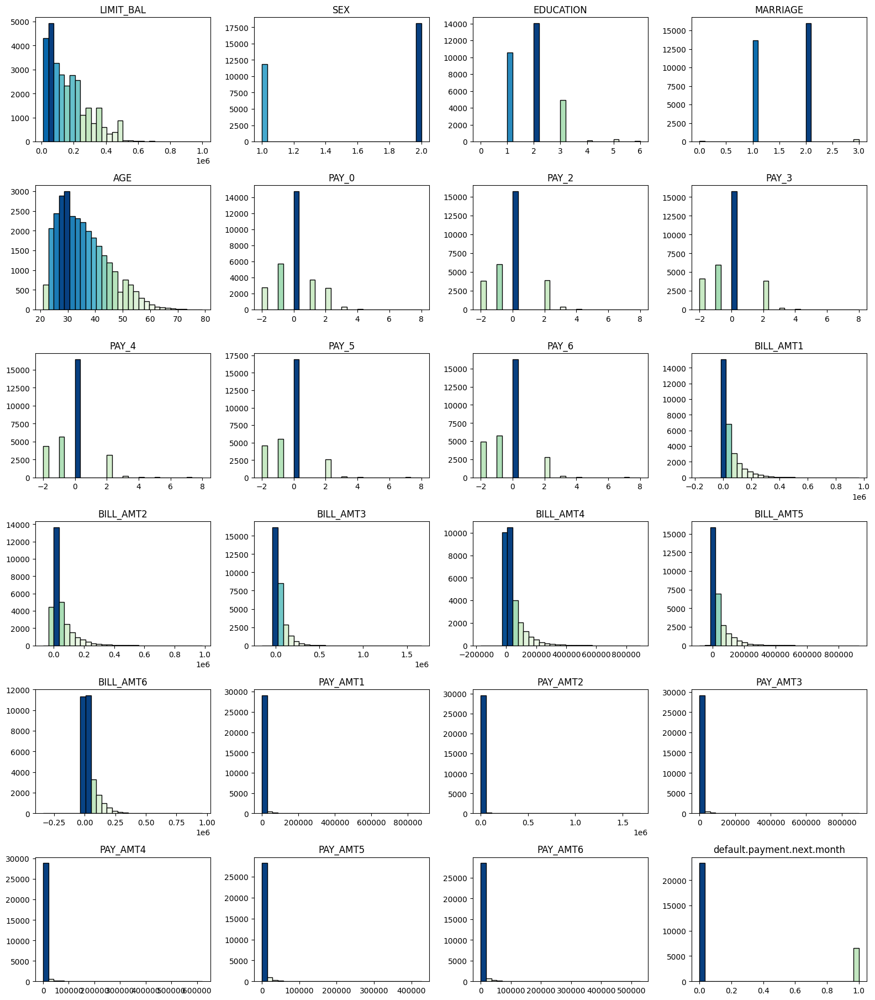

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_histograms(df, columns, cols_per_row=4):
    total = len(columns)
    rows = (total // cols_per_row) + 1
    plt.figure(figsize=(cols_per_row * 4, rows * 3))

    for i, col in enumerate(columns):
        plt.subplot(rows, cols_per_row, i + 1)
        values, bins = np.histogram(df[col].dropna(), bins=30)

        # Normalize values to [0, 1] for color mapping
        norm = Normalize(vmin=min(values), vmax=max(values))
        colors = cm.GnBu(norm(values))

        for j in range(len(values)):
            plt.bar(bins[j], values[j], width=bins[j+1] - bins[j],
                    color=colors[j], edgecolor='black', align='edge')

        plt.title(col)

    plt.tight_layout()
    plt.show()

plot_histograms(df, numeric_cols)

In [ ]:
print(df.columns.tolist())


['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'default.payment.next.month']


In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler


# Step 1: Define the target column
target = 'default.payment.next.month'

# Step 2: Separate features and target
X = df.drop(columns=[target])
y = df[target]

# Step 3: Normalize numeric features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 4: Convert back to DataFrame to preserve column names
X = pd.DataFrame(X_scaled, columns=X.columns)



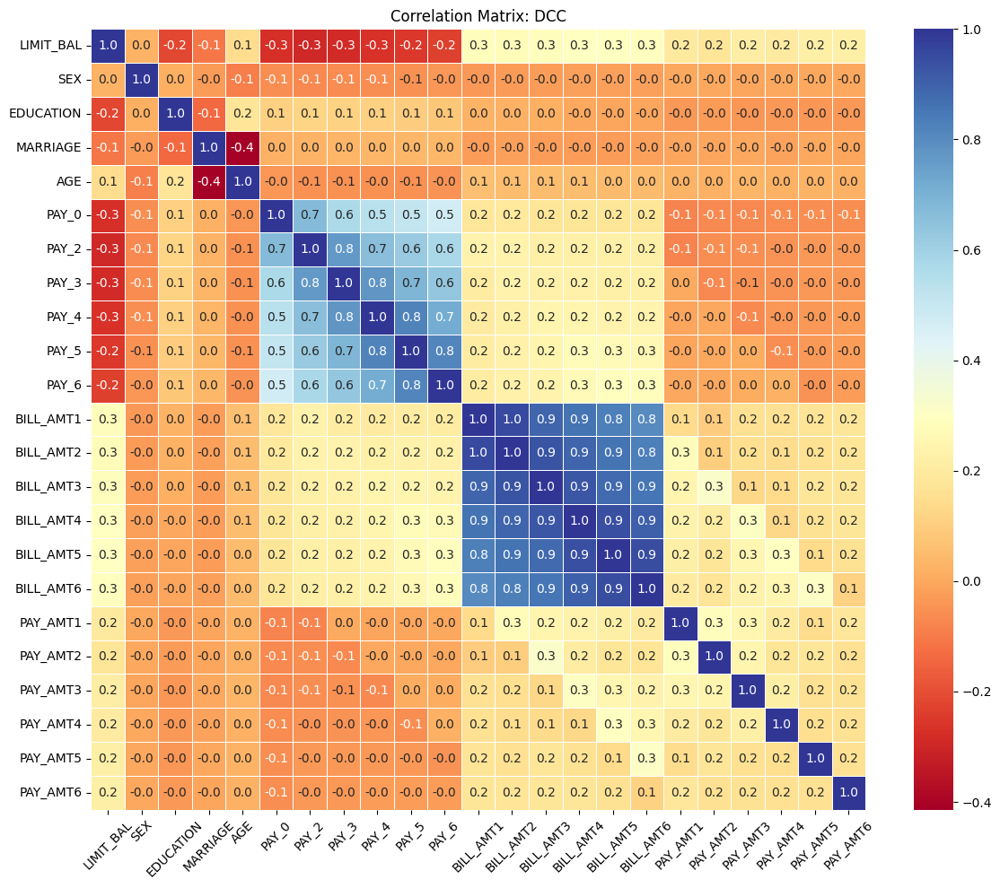

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Drop the target column
df_corr = df.drop(columns=['default.payment.next.month'])
df_corr_numeric = df_corr.select_dtypes(include=['float64', 'int64'])
corr_matrix = df_corr_numeric.corr()

# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='RdYlBu', fmt=".1f", linewidths=0.5)
plt.title('Correlation Matrix: DCC')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

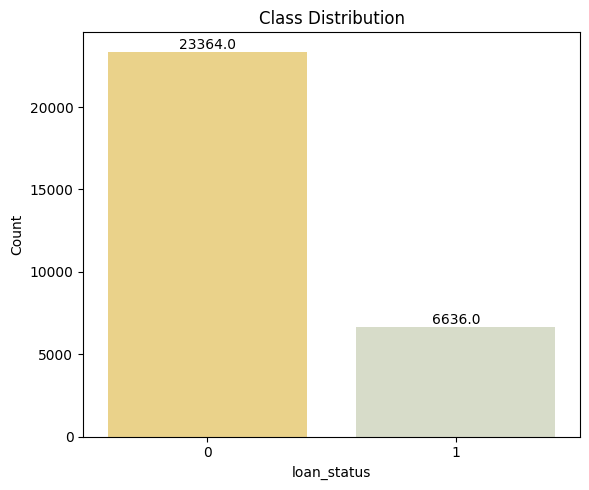

In [ ]:
plt.figure(figsize=(6, 5))
ax = sns.countplot(x='default.payment.next.month', data=df, palette=["#FADA7A", "#D9DFC6"])
plt.title("Class Distribution")
plt.xlabel("loan_status")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()

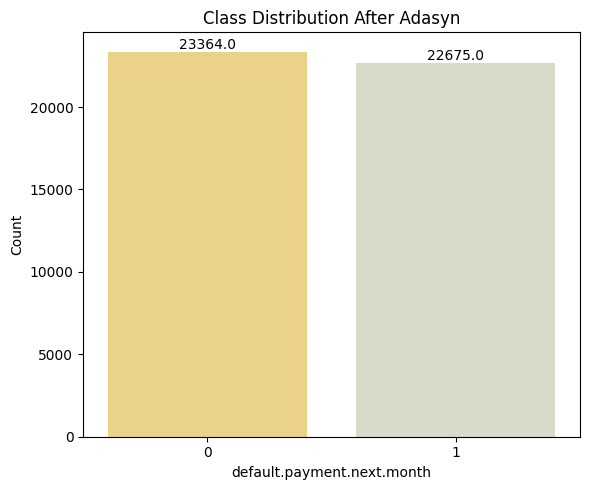


🔍 Model: Decision Tree
              precision    recall  f1-score   support

           0     0.7805    0.7466    0.7632      4673
           1     0.7501    0.7837    0.7665      4535

    accuracy                         0.7649      9208
   macro avg     0.7653    0.7652    0.7649      9208
weighted avg     0.7655    0.7649    0.7648      9208

Sensitivity (Recall): 0.7837
Specificity: 0.7466
Matthews Correlation Coefficient (MCC): 0.5305
Cohen's Kappa: 0.5300

🔍 Model: Logistic Regression
              precision    recall  f1-score   support

           0     0.6302    0.6313    0.6307      4673
           1     0.6194    0.6183    0.6188      4535

    accuracy                         0.6249      9208
   macro avg     0.6248    0.6248    0.6248      9208
weighted avg     0.6249    0.6249    0.6249      9208

Sensitivity (Recall): 0.6183
Specificity: 0.6313
Matthews Correlation Coefficient (MCC): 0.2496
Cohen's Kappa: 0.2496

🔍 Model: Random Forest
              precision    recal

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    make_scorer, matthews_corrcoef, cohen_kappa_score
)
from imblearn.over_sampling import ADASYN

# ML Models
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier


# Apply ADASYN
adasyn = ADASYN(random_state=42)
X_resampled, y_resampled = adasyn.fit_resample(X, y)

# Plot class distribution
plt.figure(figsize=(6, 5))
ax = sns.countplot(x=y_resampled, palette=["#FADA7A", "#D9DFC6"])
plt.title("Class Distribution After Adasyn")
plt.xlabel("default.payment.next.month")
plt.ylabel("Count")

# Add count labels on top of bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=10, color='black')

plt.tight_layout()
plt.show()


# ------------- Train/Test Split ---------------- #
X_train, X_test, y_train, y_test = train_test_split(
    X_resampled, y_resampled, test_size=0.2, random_state=42, stratify=y_resampled
)

# ------------- Models Dictionary ---------------- #
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'KNN': KNeighborsClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
    'LightGBM': LGBMClassifier(),
    'CatBoost': CatBoostClassifier(verbose=0)
}

# ------------- Evaluation ---------------- #
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()
    sensitivity = recall_score(y_test, y_pred)  # TP / (TP + FN)
    specificity = TN / (TN + FP)
    mcc = matthews_corrcoef(y_test, y_pred)
    kappa = cohen_kappa_score(y_test, y_pred)

    print(f"\n🔍 Model: {name}")
    print(classification_report(y_test, y_pred, digits=4))
    print(f"Sensitivity (Recall): {sensitivity:.4f}")
    print(f"Specificity: {specificity:.4f}")
    print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
    print(f"Cohen's Kappa: {kappa:.4f}")

<Figure size 1000x800 with 0 Axes>

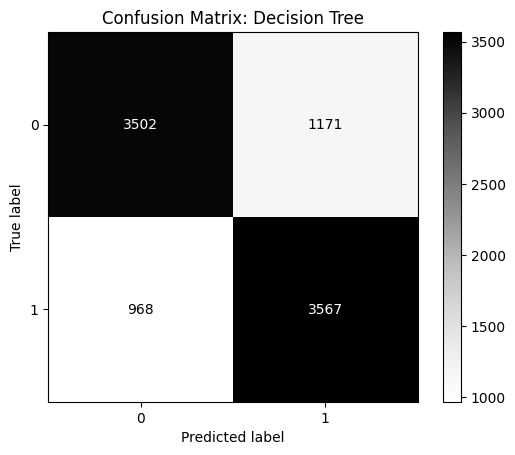

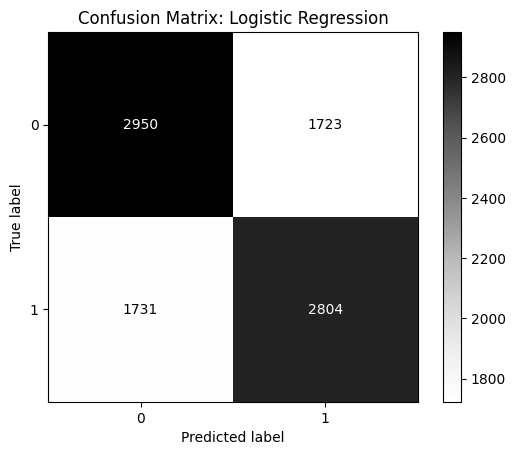

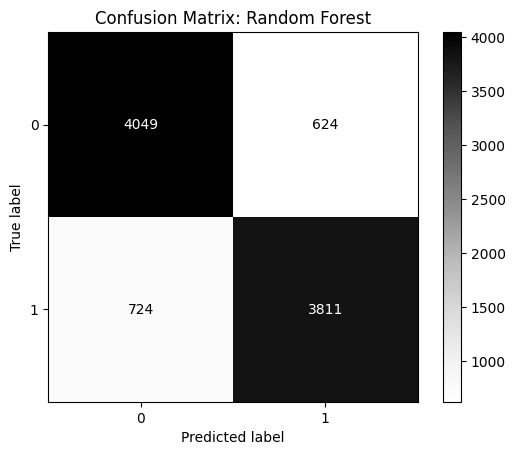

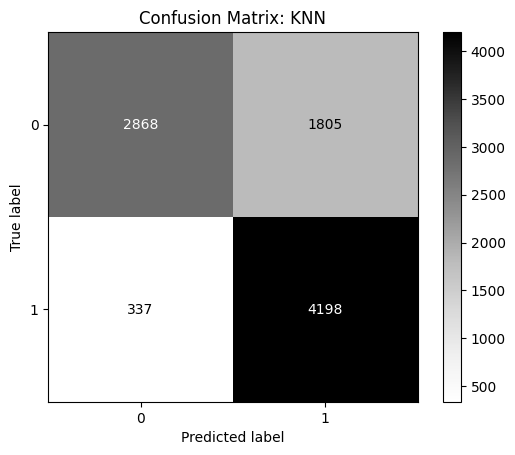

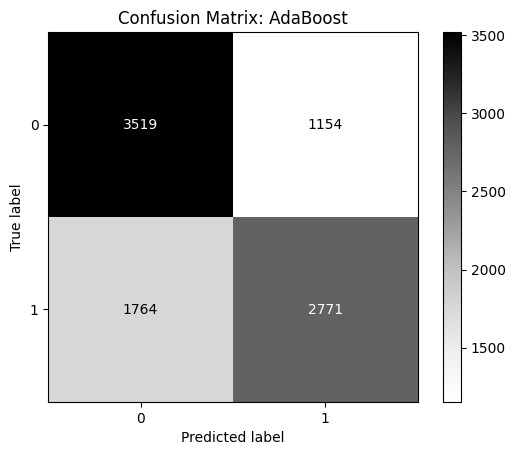

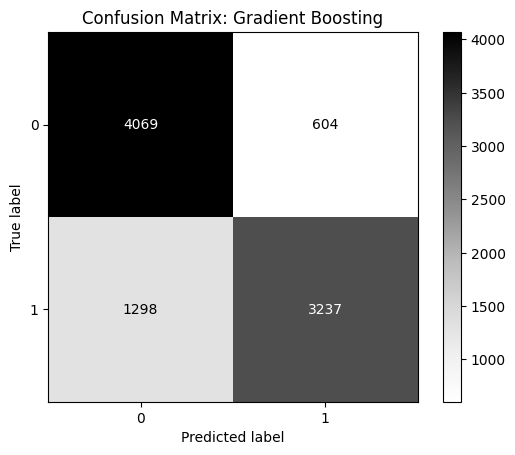

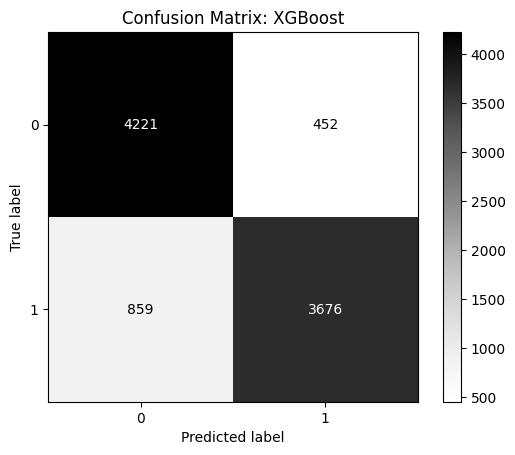

[LightGBM] [Info] Number of positive: 18140, number of negative: 18691
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5683
[LightGBM] [Info] Number of data points in the train set: 36831, number of used features: 23
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.492520 -> initscore=-0.029923
[LightGBM] [Info] Start training from score -0.029923


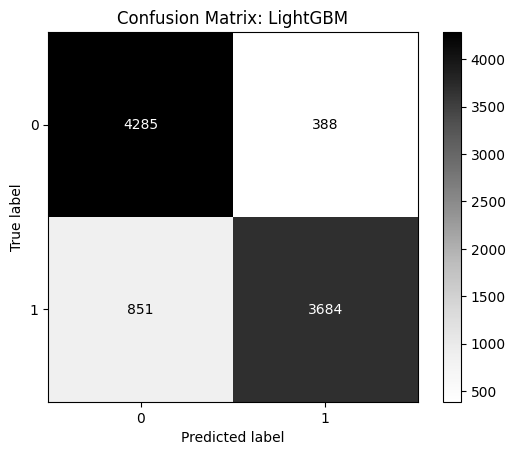

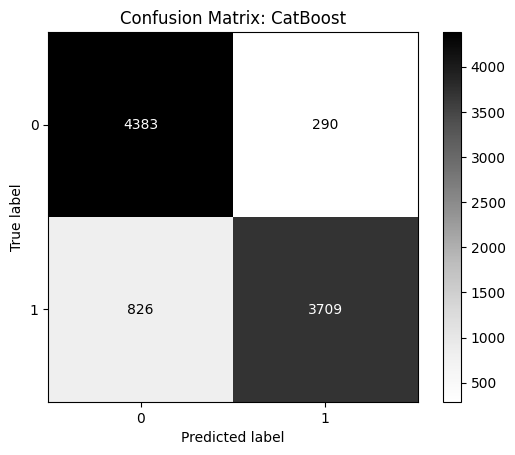

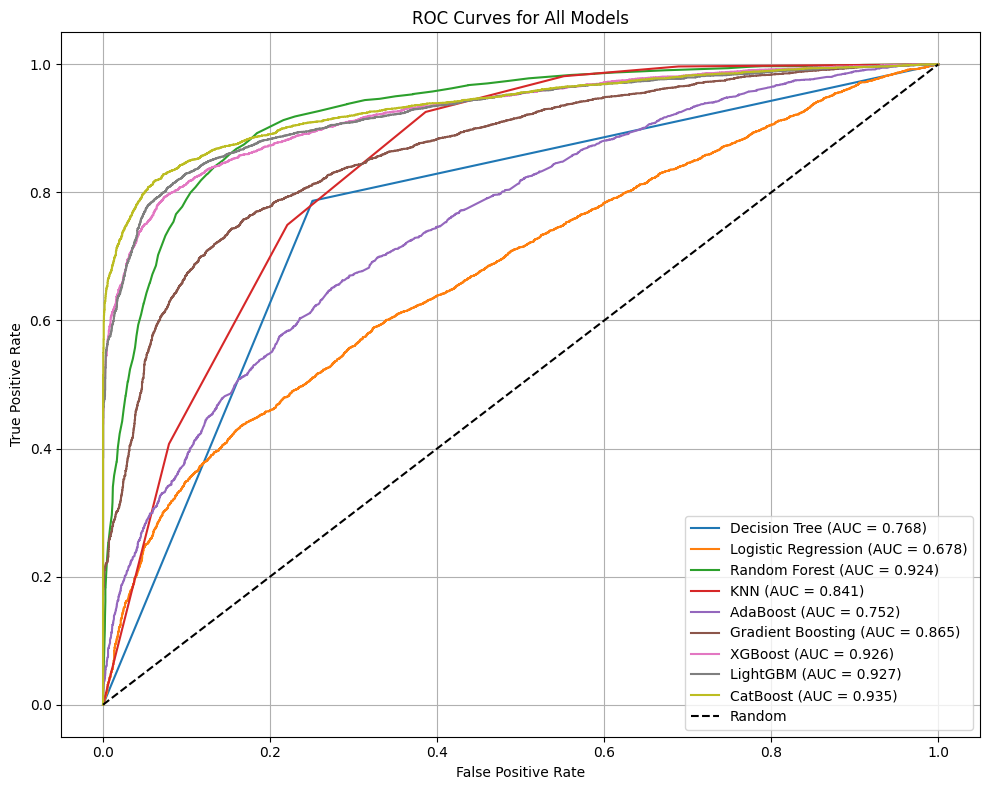

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay, roc_curve, auc
import matplotlib.pyplot as plt

# Store ROC data
plt.figure(figsize=(10, 8))
roc_data = {}

for name, model in models.items():
    # Fit model and predict
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # --- Plot Confusion Matrix ---
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(cmap='Greys')
    plt.title(f"Confusion Matrix: {name}")
    plt.show()

    # --- Calculate ROC Curve ---
    if hasattr(model, "predict_proba"):
        y_score = model.predict_proba(X_test)[:, 1]
    else:
        y_score = model.decision_function(X_test)

    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    roc_data[name] = (fpr, tpr, roc_auc)

# --- Plot All ROC Curves Together ---
plt.figure(figsize=(10, 8))
for name, (fpr, tpr, roc_auc) in roc_data.items():
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.3f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for All Models')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()


[I 2025-06-19 23:43:53,793] A new study created in memory with name: no-name-40d6de67-f5bd-4724-9a6a-225199e7ece4
[I 2025-06-19 23:46:20,821] Trial 0 finished with value: 0.8669781580725062 and parameters: {'rf_n_estimators': 181, 'rf_max_depth': 20, 'rf_min_samples_split': 3, 'xgb_n_estimators': 178, 'xgb_max_depth': 16, 'xgb_learning_rate': 0.07114937883394606, 'xgb_subsample': 0.8923982481219144, 'xgb_colsample_bytree': 0.5695502572136879, 'lr_C': 0.20040055627042797, 'meta_C': 0.03358053024872642}. Best is trial 0 with value: 0.8669781580725062.
[I 2025-06-19 23:47:19,886] Trial 1 finished with value: 0.8529279025160781 and parameters: {'rf_n_estimators': 91, 'rf_max_depth': 20, 'rf_min_samples_split': 4, 'xgb_n_estimators': 168, 'xgb_max_depth': 5, 'xgb_learning_rate': 0.15935952774512516, 'xgb_subsample': 0.9799366295861277, 'xgb_colsample_bytree': 0.5762120239303168, 'lr_C': 0.2337979561920476, 'meta_C': 4.1310201952863475}. Best is trial 0 with value: 0.8669781580725062.
[I 202

Best hyperparameters:
{'rf_n_estimators': 146, 'rf_max_depth': 14, 'rf_min_samples_split': 5, 'xgb_n_estimators': 278, 'xgb_max_depth': 20, 'xgb_learning_rate': 0.056212510260572585, 'xgb_subsample': 0.7343030786857512, 'xgb_colsample_bytree': 0.9077241797371902, 'lr_C': 1.1999145572394088, 'meta_C': 0.11166103200799755}

 BO-StaEnsemble Model Evaluation:
              precision    recall  f1-score   support

           0       0.87      0.90      0.88      4673
           1       0.89      0.86      0.88      4535

    accuracy                           0.88      9208
   macro avg       0.88      0.88      0.88      9208
weighted avg       0.88      0.88      0.88      9208

Sensitivity (Recall): 0.8584
Specificity: 0.9003
Matthews Correlation Coefficient (MCC): 0.7597
Cohen's Kappa: 0.7591


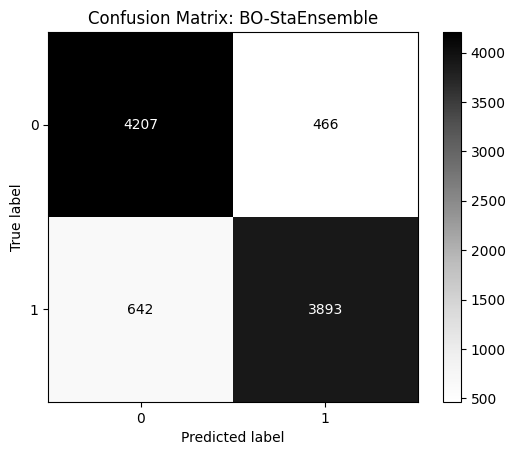

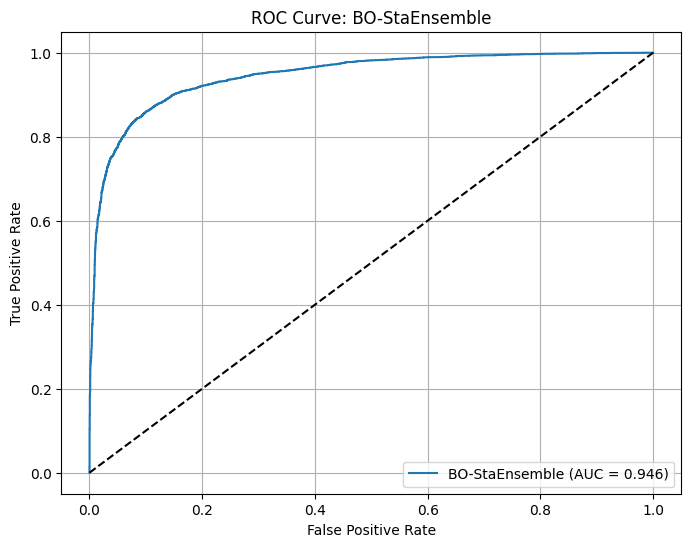

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    classification_report, confusion_matrix, recall_score,
    matthews_corrcoef, cohen_kappa_score, roc_curve, auc, ConfusionMatrixDisplay
)
from sklearn.model_selection import StratifiedKFold
import optuna
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier


# Base learners creation functions
def create_rf(trial):
    return RandomForestClassifier(
        n_estimators=trial.suggest_int('rf_n_estimators', 50, 300),
        max_depth=trial.suggest_int('rf_max_depth', 3, 20),
        min_samples_split=trial.suggest_int('rf_min_samples_split', 2, 10),
        random_state=42
    )

def create_xgb(trial):
    return XGBClassifier(
        n_estimators=trial.suggest_int('xgb_n_estimators', 50, 300),
        max_depth=trial.suggest_int('xgb_max_depth', 3, 20),
        learning_rate=trial.suggest_float('xgb_learning_rate', 0.01, 0.3),
        subsample=trial.suggest_float('xgb_subsample', 0.5, 1.0),
        colsample_bytree=trial.suggest_float('xgb_colsample_bytree', 0.5, 1.0),
        use_label_encoder=False,
        eval_metric='logloss',
        random_state=42
    )

def create_lr(trial):
    return LogisticRegression(
        C=trial.suggest_float('lr_C', 0.01, 10.0, log=True),
        max_iter=1000,
        solver='lbfgs',
        random_state=42
    )

base_learners = ['rf', 'xgb', 'lr']

# Generate out-of-fold predictions for stacking meta-features
def stacking_oof_preds(X, y, trial, n_splits=5):
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    oof_preds = {learner: np.zeros(len(y)) for learner in base_learners}

    for train_idx, val_idx in skf.split(X, y):
        X_train_fold, X_val_fold = X.iloc[train_idx], X.iloc[val_idx]
        y_train_fold = y.iloc[train_idx]

        rf = create_rf(trial)
        rf.fit(X_train_fold, y_train_fold)
        oof_preds['rf'][val_idx] = rf.predict_proba(X_val_fold)[:,1]

        xgb = create_xgb(trial)
        xgb.fit(X_train_fold, y_train_fold)
        oof_preds['xgb'][val_idx] = xgb.predict_proba(X_val_fold)[:,1]

        lr = create_lr(trial)
        lr.fit(X_train_fold, y_train_fold)
        oof_preds['lr'][val_idx] = lr.predict_proba(X_val_fold)[:,1]

    meta_features = np.column_stack([oof_preds[learner] for learner in base_learners])
    return meta_features

# Objective function for Optuna
def objective(trial):
    meta_X = stacking_oof_preds(X_train, y_train, trial)

    meta_C = trial.suggest_float('meta_C', 0.01, 10.0, log=True)
    meta_model = LogisticRegression(C=meta_C, max_iter=1000, random_state=42)

    meta_model.fit(meta_X, y_train)
    preds = meta_model.predict(meta_X)
    return f1_score(y_train, preds)

# Run the optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)

print("Best hyperparameters:")
print(study.best_trial.params)

# Retrain base learners on full training set with best params
best_params = study.best_trial.params

rf_best = RandomForestClassifier(
    n_estimators=best_params['rf_n_estimators'],
    max_depth=best_params['rf_max_depth'],
    min_samples_split=best_params['rf_min_samples_split'],
    random_state=42
)
xgb_best = XGBClassifier(
    n_estimators=best_params['xgb_n_estimators'],
    max_depth=best_params['xgb_max_depth'],
    learning_rate=best_params['xgb_learning_rate'],
    subsample=best_params['xgb_subsample'],
    colsample_bytree=best_params['xgb_colsample_bytree'],
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)
lr_best = LogisticRegression(
    C=best_params['lr_C'],
    max_iter=1000,
    solver='lbfgs',
    random_state=42
)

# Fit base learners on full training set
rf_best.fit(X_train, y_train)
xgb_best.fit(X_train, y_train)
lr_best.fit(X_train, y_train)

# Create meta features for train and test
def create_meta_features(models, X):
    meta_features = np.column_stack([
        model.predict_proba(X)[:,1] for model in models
    ])
    return meta_features

base_models = [rf_best, xgb_best, lr_best]

meta_X_train = create_meta_features(base_models, X_train)
meta_X_test = create_meta_features(base_models, X_test)

# Train meta learner with best meta_C
meta_model = LogisticRegression(C=best_params['meta_C'], max_iter=1000, random_state=42)
meta_model.fit(meta_X_train, y_train)

# Final predictions
y_pred = meta_model.predict(meta_X_test)
y_proba = meta_model.predict_proba(meta_X_test)[:,1]

# Evaluation metrics
cm = confusion_matrix(y_test, y_pred)
TN, FP, FN, TP = cm.ravel()
sensitivity = recall_score(y_test, y_pred)  # Recall
specificity = TN / (TN + FP)
mcc = matthews_corrcoef(y_test, y_pred)
kappa = cohen_kappa_score(y_test, y_pred)

print("\n BO-StaEnsemble Model Evaluation:")
print(classification_report(y_test, y_pred))
print(f"Sensitivity (Recall): {sensitivity:.4f}")
print(f"Specificity: {specificity:.4f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.4f}")
print(f"Cohen's Kappa: {kappa:.4f}")

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap='Greys')
plt.title("Confusion Matrix: BO-StaEnsemble")
plt.show()

# Plot ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, label=f'BO-StaEnsemble (AUC = {roc_auc:.3f})')
plt.plot([0,1], [0,1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve: BO-StaEnsemble')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


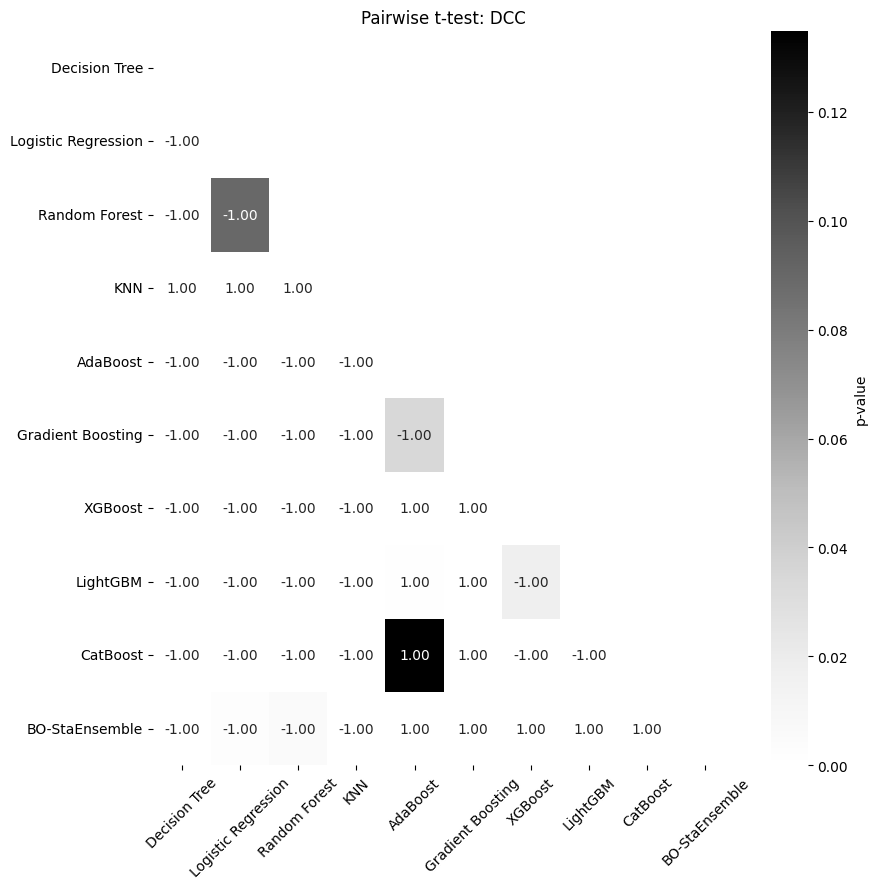

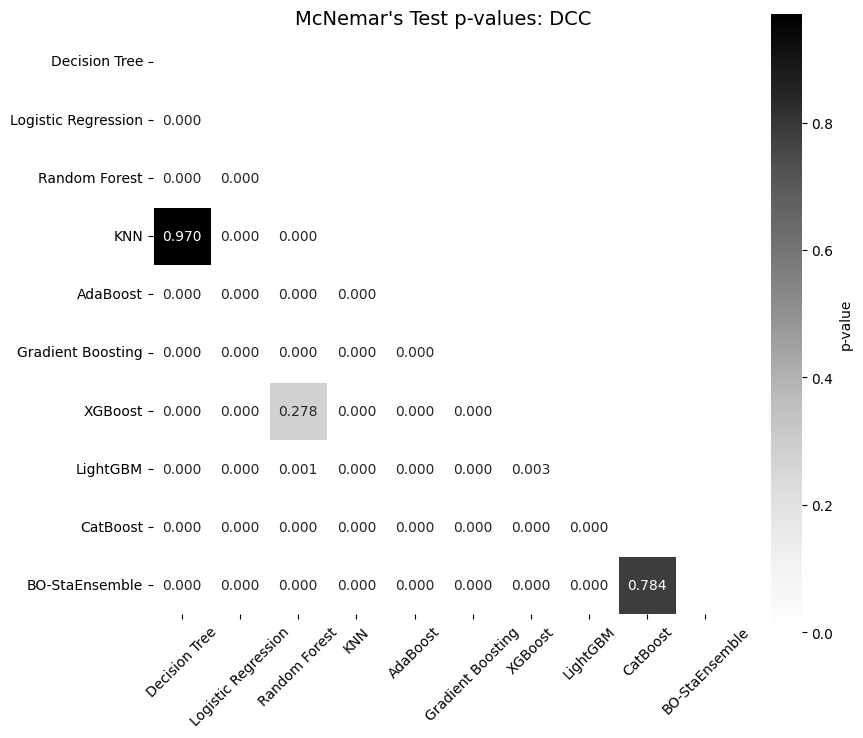

In [ ]:
from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Store predictions from trained models
model_preds = {}
for name, model in models.items():
    model_preds[name] = model.predict(X_test)

# Add BO-StaEnsemble prediction manually (assuming already available)
model_preds['BO-StaEnsemble'] = y_pred  # y_pred from BO-StaEnsemble

from scipy.stats import ttest_rel
from statsmodels.stats.contingency_tables import mcnemar
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

model_names = list(model_preds.keys())
n_models = len(model_names)

# Initialize matrices
t_stat_matrix = np.zeros((n_models, n_models))
p_val_matrix = np.zeros((n_models, n_models))
mcnemar_p_matrix = np.ones((n_models, n_models))

# Run tests
for i in range(n_models):
    for j in range(n_models):
        if i == j:
            continue
        pred_i = model_preds[model_names[i]]
        pred_j = model_preds[model_names[j]]

        # Paired t-test
        t_stat, p_val = ttest_rel(pred_i, pred_j)
        t_stat_matrix[i, j] = np.sign(t_stat)
        p_val_matrix[i, j] = p_val

        # McNemar's Test
        b = np.logical_and(pred_i == y_test, pred_j != y_test).sum()
        c = np.logical_and(pred_i != y_test, pred_j == y_test).sum()
        table = np.array([[0, b], [c, 0]])
        try:
            result = mcnemar(table, exact=True)
            mcnemar_p_matrix[i, j] = result.pvalue
        except:
            mcnemar_p_matrix[i, j] = np.nan

# Convert to DataFrames
t_stat_df = pd.DataFrame(t_stat_matrix, index=model_names, columns=model_names)
p_val_df = pd.DataFrame(p_val_matrix, index=model_names, columns=model_names)
mcnemar_p_df = pd.DataFrame(mcnemar_p_matrix, index=model_names, columns=model_names)

# Heatmap: t-test p-values & signs
plt.figure(figsize=(9, 9))
sns.heatmap(p_val_df, annot=t_stat_df, fmt='.2f', cmap='Greys',
            mask=np.triu(np.ones_like(p_val_df, dtype=bool)),
            cbar_kws={'label': 'p-value'})
plt.title('Pairwise t-test: DCC')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# Heatmap: McNemar's p-values (Lower Triangle Only)
mask = np.triu(np.ones_like(mcnemar_p_df, dtype=bool))  # Upper triangle mask

plt.figure(figsize=(9, 9))
sns.heatmap(mcnemar_p_df, annot=True, fmt=".3f", cmap="Greys",
            mask=mask, linewidths=0.5, square=True,
            cbar_kws={"label": "p-value", "shrink": .75})
plt.title("McNemar's Test p-values: DCC", fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



In [ ]:
# Print Pairwise t-test p-values (Lower Triangle Only)
print("📌 Pairwise t-test p-values (lower triangle):\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {p_val_matrix[i, j]:.4f}")
print("\n")

# Print Pairwise t-statistic signs (Upper Triangle Only)
print("📌 Pairwise t-test t-statistic sign (upper triangle):\n")
for i in range(n_models):
    for j in range(i+1, n_models):
        sign = "+" if t_stat_matrix[i, j] > 0 else "-" if t_stat_matrix[i, j] < 0 else "0"
        print(f"{model_names[i]} vs {model_names[j]}: t-sign = {sign}")
print("\n")

# Print Pairwise McNemar's Test p-values
print("📌 Pairwise McNemar's Test p-values:\n")
for i in range(n_models):
    for j in range(i):
        print(f"{model_names[i]} vs {model_names[j]}: p-value = {mcnemar_p_matrix[i, j]:.4f}")


📌 Pairwise t-test p-values (lower triangle):

Logistic Regression vs Decision Tree: p-value = 0.0004
Random Forest vs Decision Tree: p-value = 0.0000
Random Forest vs Logistic Regression: p-value = 0.0897
KNN vs Decision Tree: p-value = 0.0000
KNN vs Logistic Regression: p-value = 0.0000
KNN vs Random Forest: p-value = 0.0000
AdaBoost vs Decision Tree: p-value = 0.0000
AdaBoost vs Logistic Regression: p-value = 0.0000
AdaBoost vs Random Forest: p-value = 0.0000
AdaBoost vs KNN: p-value = 0.0000
Gradient Boosting vs Decision Tree: p-value = 0.0000
Gradient Boosting vs Logistic Regression: p-value = 0.0000
Gradient Boosting vs Random Forest: p-value = 0.0000
Gradient Boosting vs KNN: p-value = 0.0000
Gradient Boosting vs AdaBoost: p-value = 0.0342
XGBoost vs Decision Tree: p-value = 0.0000
XGBoost vs Logistic Regression: p-value = 0.0000
XGBoost vs Random Forest: p-value = 0.0000
XGBoost vs KNN: p-value = 0.0000
XGBoost vs AdaBoost: p-value = 0.0000
XGBoost vs Gradient Boosting: p-value 

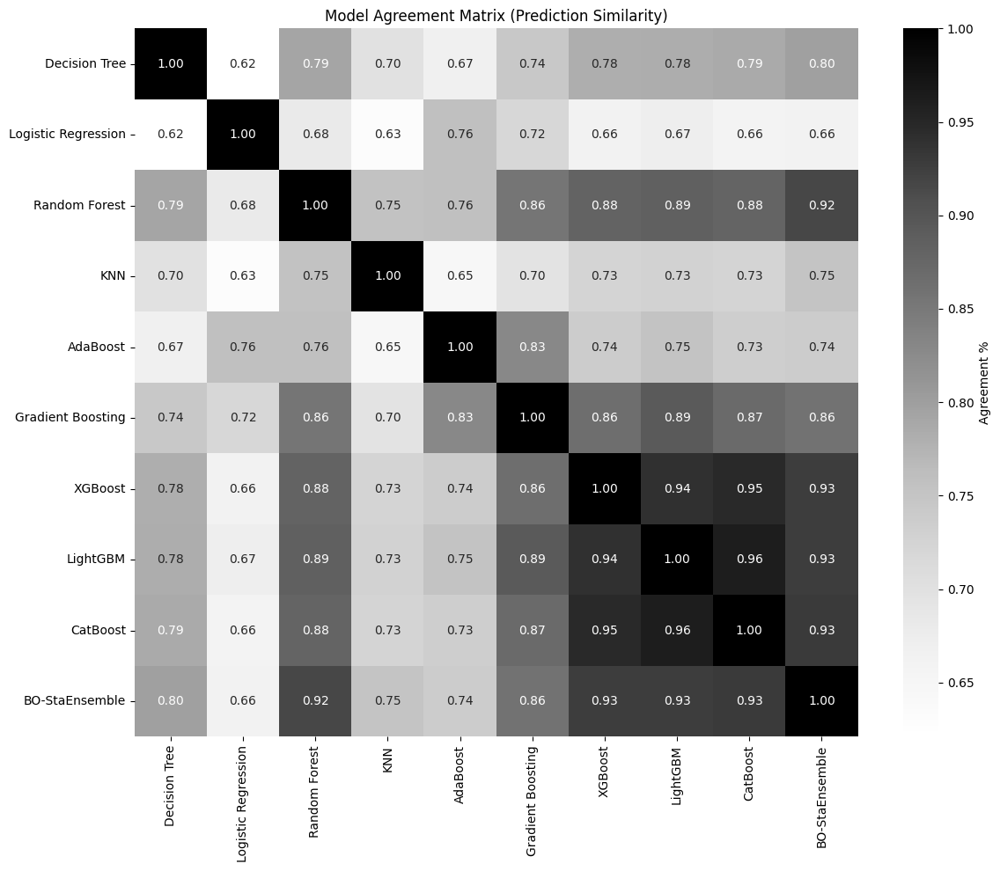

In [ ]:
# Agreement Matrix (percentage of same predictions between model pairs)
agreement_matrix = np.zeros((n_models, n_models))

for i in range(n_models):
    for j in range(n_models):
        agree = (model_preds[model_names[i]] == model_preds[model_names[j]]).mean()
        agreement_matrix[i, j] = agree

# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(agreement_matrix, annot=True, fmt=".2f", cmap="Greys",
            xticklabels=model_names, yticklabels=model_names,
            cbar_kws={"label": "Agreement %"})
plt.title("Model Agreement Matrix (Prediction Similarity)")
plt.tight_layout()
plt.show()


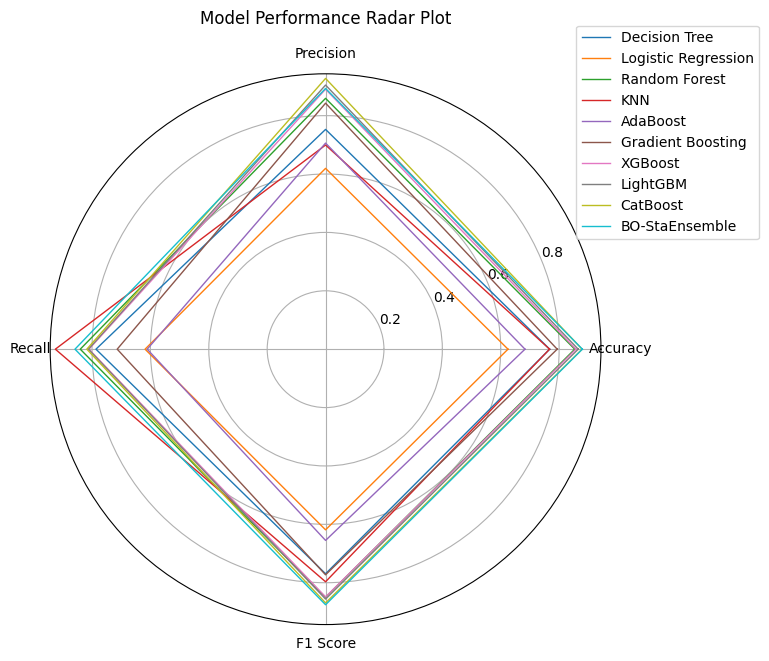

In [ ]:
from sklearn.metrics import accuracy_score, f1_score
from math import pi

# Collect metrics
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
radar_data = []

for name in model_names:
    y_pred = model_preds[name]
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    radar_data.append([acc, prec, rec, f1])

# Radar plot setup
categories = metrics
N = len(categories)

plt.figure(figsize=(8, 15))
for i, scores in enumerate(radar_data):
    values = scores + [scores[0]]
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
    plt.polar(angles, values, label=model_names[i], linewidth=1)

plt.xticks([n / float(N) * 2 * pi for n in range(N)], categories)
plt.title('Model Performance Radar Plot\n\n')
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


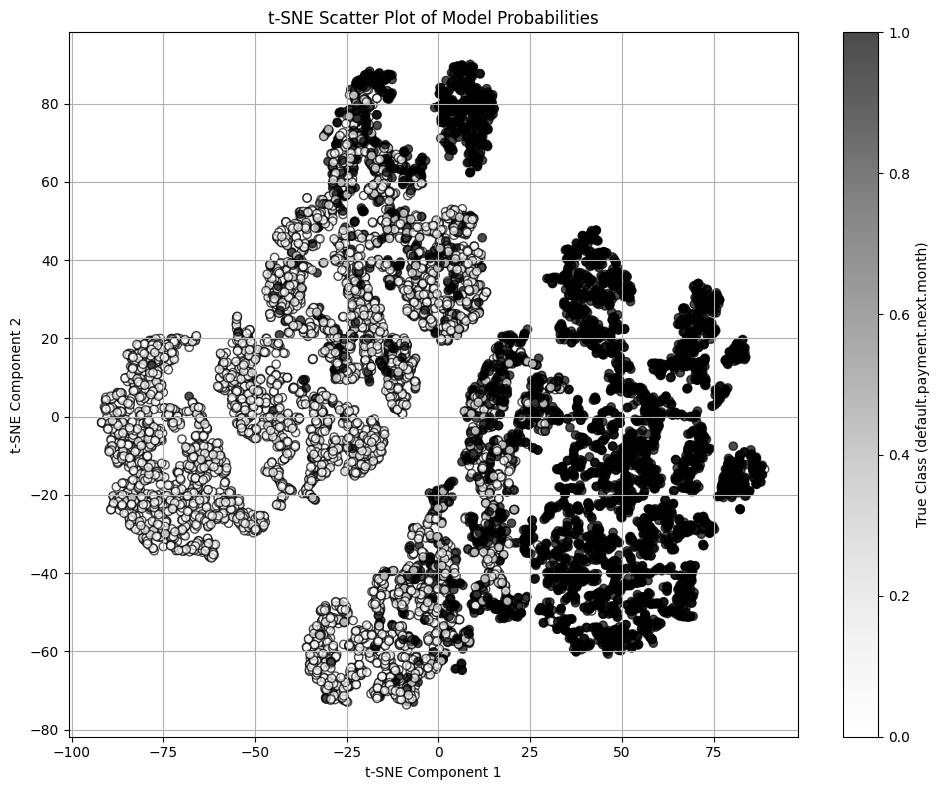

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Collect model predicted probabilities (if available)
model_probs = {}
for name, model in models.items():
    if hasattr(model, "predict_proba"):
        model_probs[name] = model.predict_proba(X_test)[:, 1]
    else:
        model_probs[name] = model.decision_function(X_test)  # fallback for SVM

# Include BO-StaEnsemble
model_probs['BO-StaEnsemble'] = y_proba  # from BO model

# Create dataframe for PCA input
probs_df = pd.DataFrame(model_probs)
probs_scaled = StandardScaler().fit_transform(probs_df)
# t-SNE (takes longer than PCA)
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
tsne_components = tsne.fit_transform(probs_scaled)

# Plot
plt.figure(figsize=(10, 8))
scatter = plt.scatter(tsne_components[:, 0], tsne_components[:, 1],
                      c=y_test, cmap='Greys', alpha=0.7, edgecolor='k')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE Scatter Plot of Model Probabilities')
plt.colorbar(scatter, label='True Class (default.payment.next.month)')
plt.grid(True)
plt.tight_layout()
plt.show()


Explainable AI

Intercept 0.9584212599773186
Prediction_local [0.97598984]
Right: 0.031191433


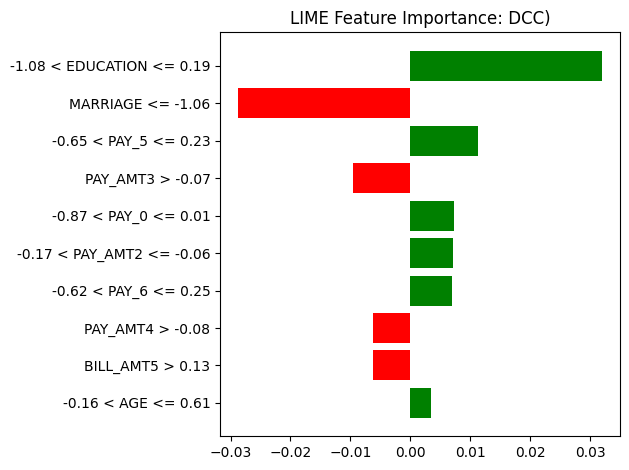

In [ ]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt

# LIME explainer for original input features
explainer_xgb = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns.tolist(),
    class_names=['Non-Default', 'Default'],
    mode='classification',
    verbose=True,
    random_state=42
)

# Choose one sample from the test set
i = 5  # change index as needed
exp = explainer_xgb.explain_instance(
    data_row=X_test.iloc[i].values,
    predict_fn=xgb_best.predict_proba,
    num_features=10  # top 10 features
)

# Show the explanation
exp.show_in_notebook(show_table=True)
fig = exp.as_pyplot_figure()
plt.title(f"LIME Feature Importance: DCC)")
plt.tight_layout()
plt.show()


100%|===================| 9204/9208 [27:28<00:00]       

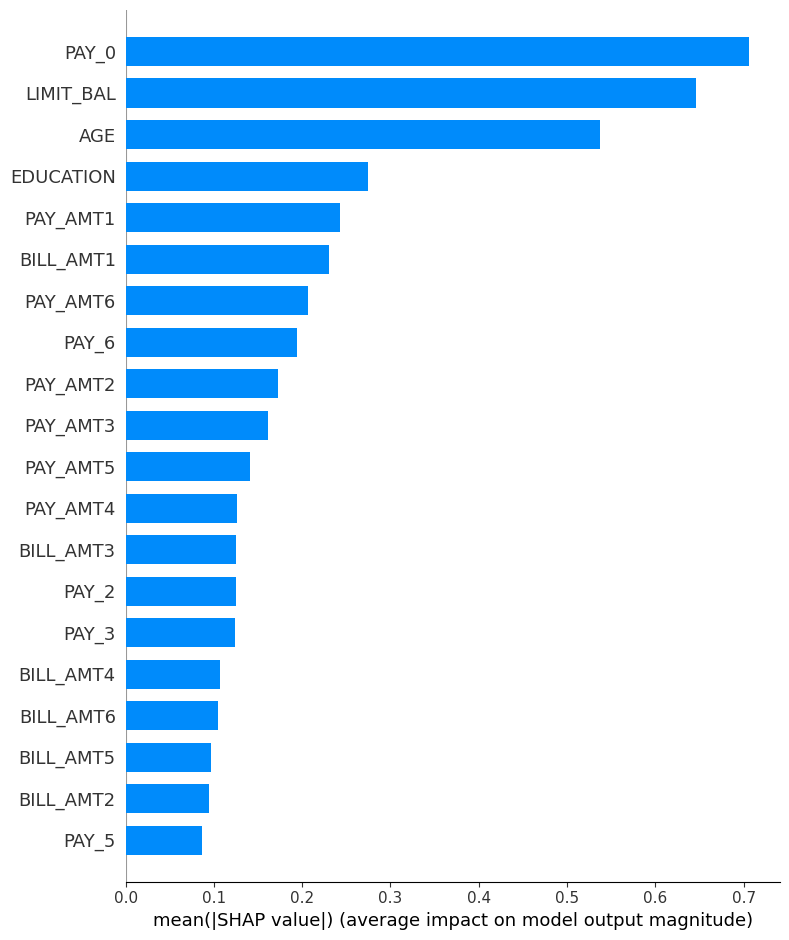

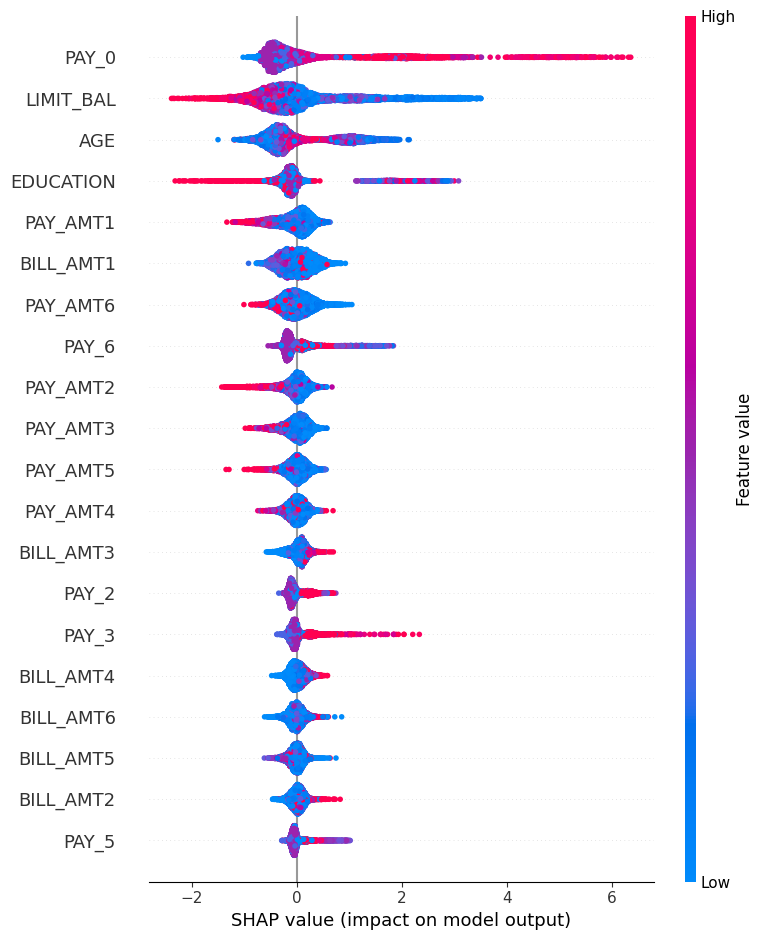

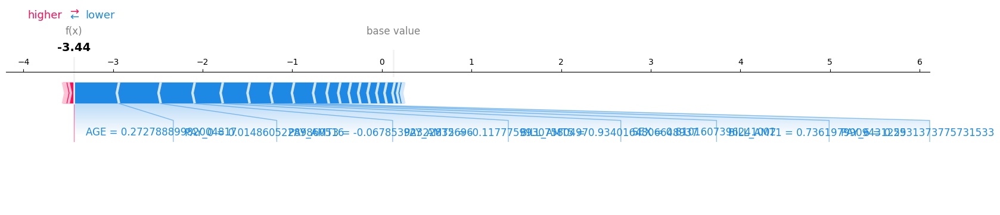

In [ ]:
import shap
import matplotlib.pyplot as plt

# Create SHAP explainer for XGBoost model
explainer = shap.Explainer(xgb_best, X_train)

# Calculate SHAP values for the test set
shap_values = explainer(X_test)

# Summary plot: global feature importance
shap.summary_plot(shap_values, X_test, plot_type="bar", show=True)

# Detailed beeswarm plot: direction & distribution
shap.summary_plot(shap_values, X_test, show=True)

# Force plot for a specific instance (optional)
i = 5  # sample index
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[i].values, X_test.iloc[i], matplotlib=True)


In [ ]:
pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 44.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 42.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 50.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 53.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 39.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.8/259.8 kB 20.0 MB/s eta 0:00:00
  Created wheel for dash-cytoscape: filename=dash_cytoscape-1.0.2-py3-none-any.whl size=4010717 sha256=a01800821fd9ab74ad813f944c91c0eb2e1a4cfe7d3454dc8811f475a77beac4
  S

In [ ]:

from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret import show
from interpret.blackbox import MorrisSensitivity

# Remove the extraneous XGBClassifier() call
# XGBClassifier() # This line is not needed

print("\n--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---")

# Apply MorrisSensitivity directly to your trained xgb_best model and the original X_train data
msa = MorrisSensitivity(xgb_best, X_train)

# Generate and show the global explanation for the XGBoost model
show(msa.explain_global())


--- Performing Morris Sensitivity Analysis with interpret library on XGBoost ---
